# Annotation

In [293]:
import pandas as pd
import numpy as np
import scanpy as sc
import scanpy.external as sce
import matplotlib.pyplot as plt
import scipy
import seaborn as sns
import harmonypy as hm

## PFC:

In [3]:
data = sc.read_h5ad("/cndd/xic007/scorch/SCORCH_NHP/Processed_h5ad/RNA_241202_NHP_PFC_5samples_normalized_doublet_58142cells.h5ad")

In [274]:
#PFC marker genes -> update these from papers
# pfc_genes = {
#     'excitatory_neuron': ['SLC17A6', 'SLC17A7', 'NEUROD2', 'NEUROD6'],
#     'inhibitory_neuron': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
#     'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
#     'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
#     'OPC': ['SOX10', 'OLIG2'],
#     'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}

pfc_genes = {
    'excitatory_neuron': ['SLC17A7'],
    'inhibitory_neuron': ['GAD1'],
    'oligodendrocyte': ['PLP1'],
    'astrocyte': ['AQP4'],
    'OPC': ['OLIG2'],
    'microglia': ['P2RY12']}

In [21]:
data

AnnData object with n_obs × n_vars = 58142 × 19808
    obs: 'Sample_id', 'Condition', 'Brain Region', 'Doublet Score', 'Predicted Doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'percent_mito', 'percent_ribo', 'n_genes', 'Sample_region', 'leiden'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Brain Region_colors', 'Sample_id_colors', 'Sample_region_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'RNA_raw'
    obsp: 'connectivities', 'distances'

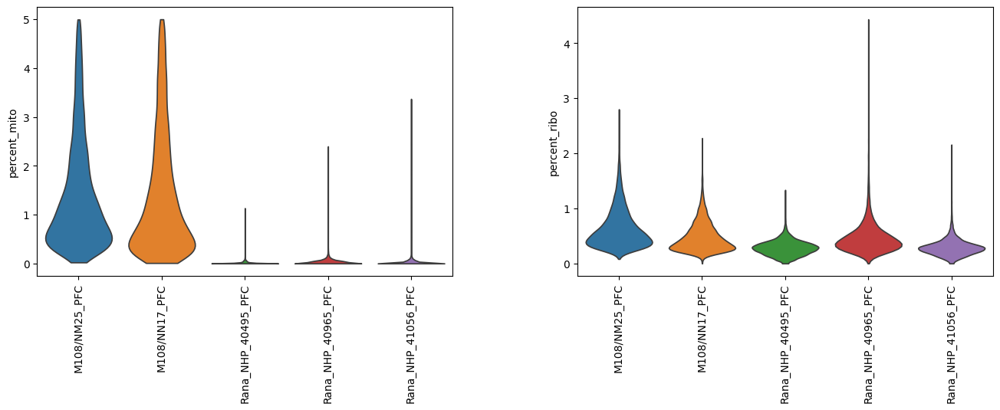

In [9]:
sc.pl.violin(data, ['percent_mito','percent_ribo'], stripplot = False,
             jitter=0.4, groupby = "Sample_region", rotation=90)
plt.show()

excitatory


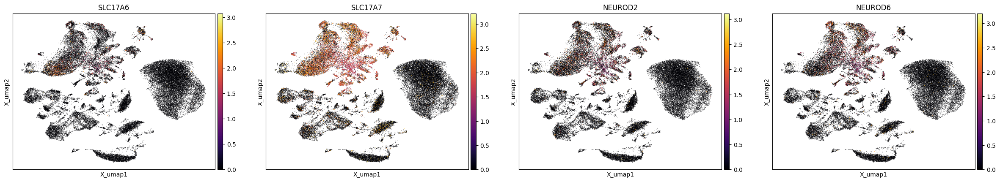

inhibitory


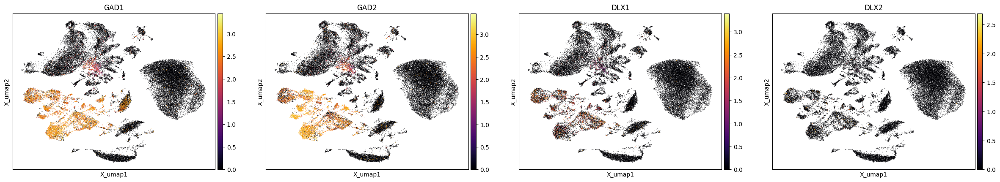

opc


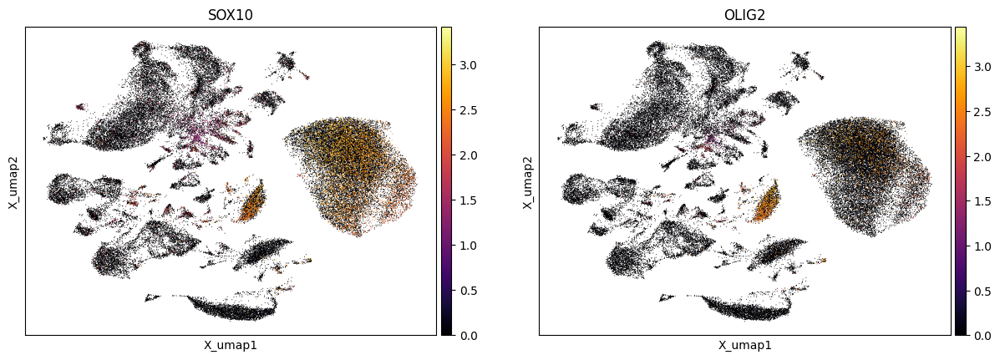

oligodendrocyte


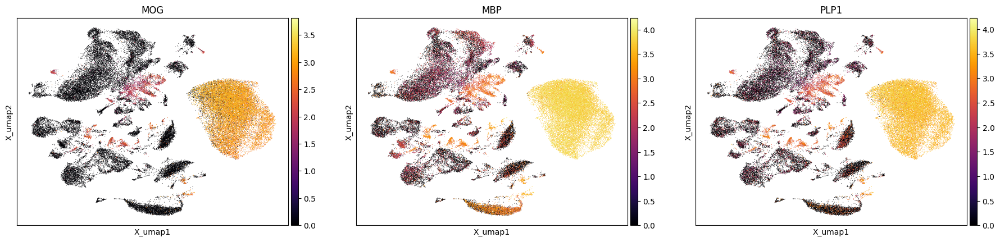

astrocyte


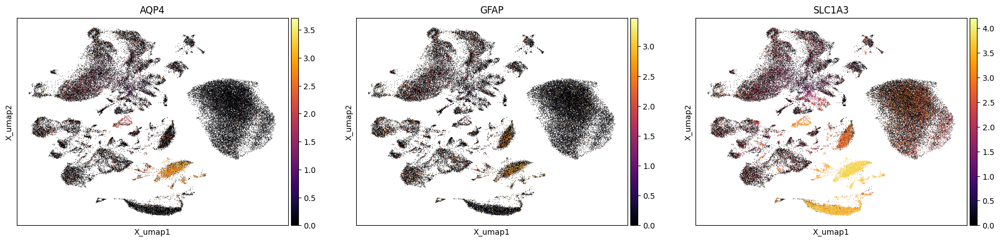

microglia


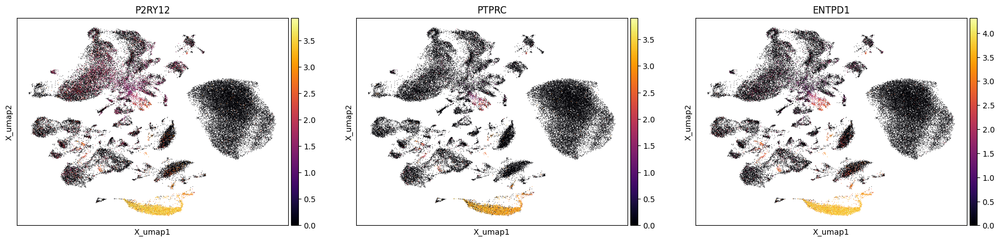

In [20]:

print('excitatory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['excitatory_neuron'], 
                use_raw = False, cmap = "inferno")
print('inhibitory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['inhibitory_neuron'], 
                use_raw = False, cmap = "inferno")

print('opc')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['OPC'], 
                use_raw = False, cmap = "inferno")

print('oligodendrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['oligodendrocyte'], 
                use_raw = False, cmap = "inferno")

print('astrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['astrocyte'], 
                use_raw = False, cmap = "inferno")

print('microglia')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['microglia'], 
                use_raw = False, cmap = "inferno")

In [275]:

#allocate coarse labels based on mean expression
emp = np.full(data.obs.shape[0], 'undefined', dtype=object)
leid = np.asarray(data.obs['leiden'].values)

#neurons first
thresh = 0.7
for key in list(pfc_genes.keys())[:2]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]
            else:
                # If key not already in the label, append it
                if key not in current_label.split('_'):
                    emp[cluster_mask] = 'excitatory_inhibitory' #current_label + '_' + key[:4]

#glia
thresh = 0.5
for key in list(pfc_genes.keys())[2:]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]

            elif pd.Series(current_label).str.contains('exci|inh')[0] == False:
                emp[cluster_mask] = 'mixed_glia' #current_label + '_' + key[:4]


# Assign coarse labels to the data object
data.obs['coarse_labels'] = emp


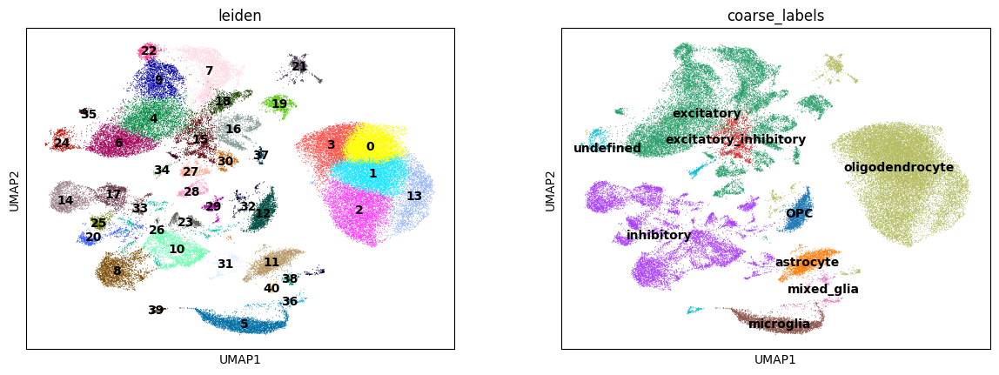

In [276]:
#UMAP labels
sc.pl.umap(data, color = ['leiden', 'coarse_labels'], legend_loc = 'on data')

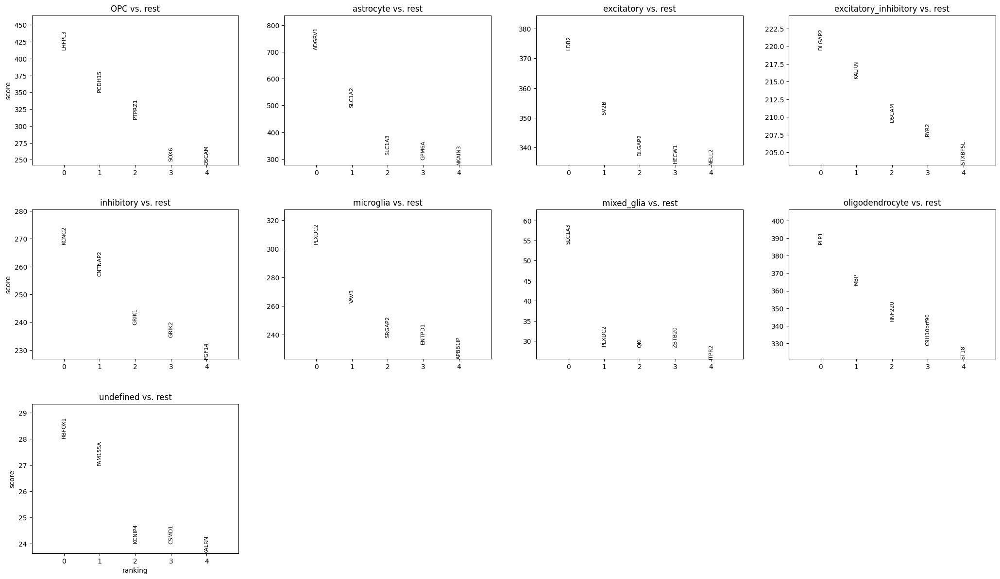

In [258]:
# Find marker genes for each `coarse_labels` group
sc.tl.rank_genes_groups(data, groupby='coarse_labels', method='t-test')  # Use appropriate method (e.g., 't-test', 'wilcoxon')

# Display the results
sc.pl.rank_genes_groups(data, n_genes=5, sharey=False)


In [259]:
import pandas as pd

# Extract the results into a DataFrame
marker_genes = pd.DataFrame(
    {
        group: data.uns['rank_genes_groups']['names'][group][:5]
        for group in data.uns['rank_genes_groups']['names'].dtype.names
    }
)

# Display the top marker genes
print(marker_genes)


      OPC astrocyte excitatory excitatory_inhibitory inhibitory microglia  \
0  LHFPL3    ADGRV1       LDB2                DLGAP2      KCNC2    PLXDC2   
1  PCDH15    SLC1A2       SV2B                 KALRN    CNTNAP2      VAV3   
2  PTPRZ1    SLC1A3     DLGAP2                 DSCAM      GRIK1    SRGAP2   
3    SOX6     GPM6A      HECW1                  RYR2      GRIK2    ENTPD1   
4   DSCAM    NKAIN3      NELL2               STXBP5L      FGF14   APBB1IP   

  mixed_glia oligodendrocyte undefined  
0     SLC1A3            PLP1    RBFOX1  
1     PLXDC2             MBP   FAM155A  
2        QKI          RNF220    KCNIP4  
3     ZBTB20      C9H10orf90     CSMD1  
4      ITPR2            ST18     KALRN  


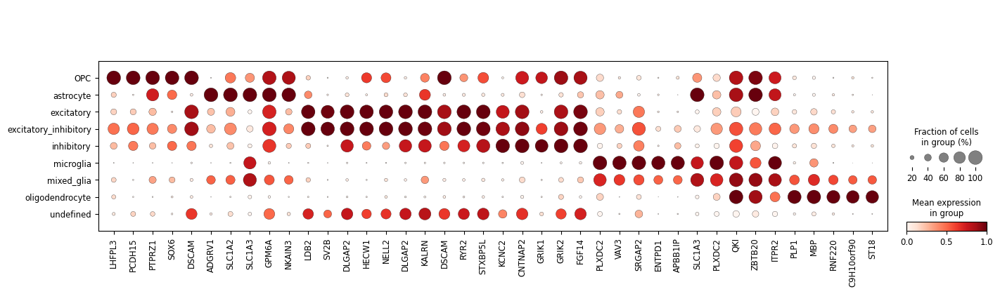

In [264]:
# Flatten and reorder marker genes
marker_genes = marker_genes.loc[:, marker_genes.columns != 'undefined']

# Flatten and reorder marker genes
ordered_marker_genes = []
for group in marker_genes.columns:
    ordered_marker_genes.extend(marker_genes[group].tolist())

# Generate the dot plot
sc.pl.dotplot(data, var_names=ordered_marker_genes, groupby='coarse_labels', standard_scale='var')


In [ ]:
(data.obs['coarse_labels'

/tmp/ipykernel_54735/698868459.py:17: FutureWarning: The behavior of Series.argsort in the presence of NA values is deprecated. In a future version, NA values will be ordered last instead of set to -1.
  fdata = fdata[fdata.obs['coarse_labels'].argsort()]


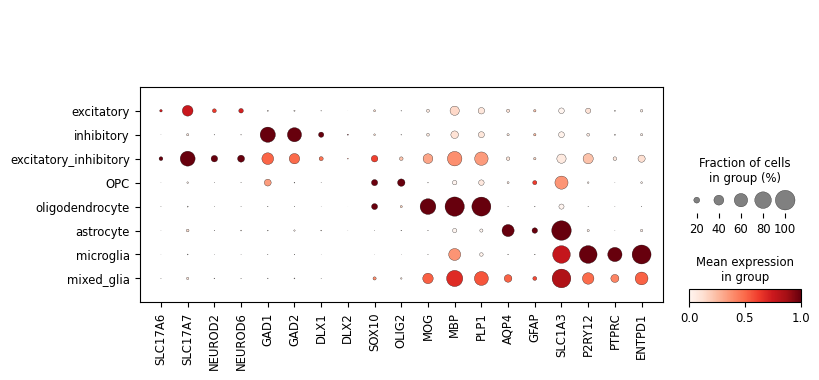

In [277]:
_genes = {
    'excitatory': ['SLC17A6', 'SLC17A7', 'NEUROD2', 'NEUROD6'],
    'inhibitory': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
    'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
    'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
    'OPC': ['SOX10', 'OLIG2'],
    'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}

# Define the desired order for coarse_labels: neurons first, then glia
desired_order = ['excitatory', 'inhibitory', 'excitatory_inhibitory', 'OPC', 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Reorder `coarse_labels` in the dataset
fdata = data.copy()
fdata.obs['coarse_labels'] = pd.Categorical(fdata.obs['coarse_labels'], categories=desired_order, ordered=True)

# Sort the dataset by the new coarse_labels order
fdata = fdata[fdata.obs['coarse_labels'].argsort()]


# Flatten and reorder genes from pfc_genes based on `desired_order`
ordered_genes = []
for label in desired_order:
    if label in _genes:
        ordered_genes.extend(_genes[label])

# Plot the dot plot
sc.pl.dotplot(fdata, var_names=ordered_genes, groupby='coarse_labels', standard_scale='var')



/tmp/ipykernel_54735/3668545709.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


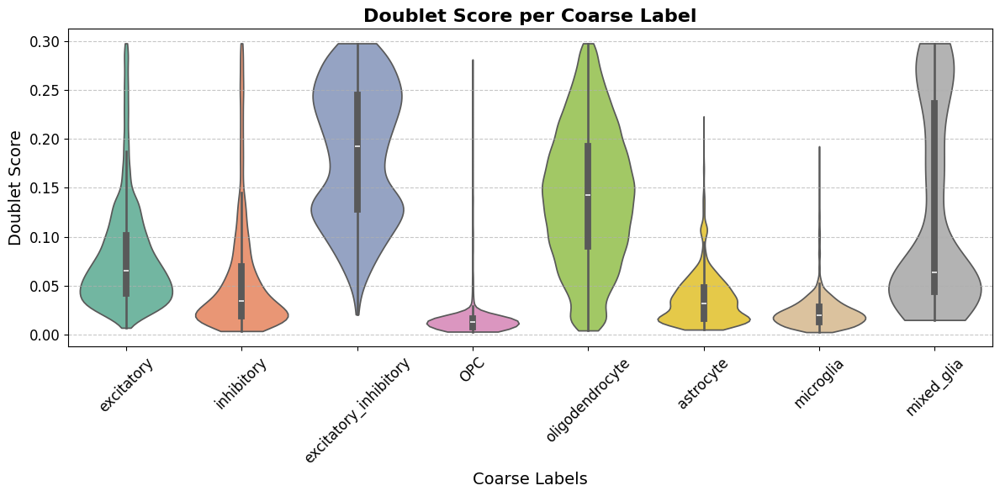

In [292]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'excitatory_inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for doublet scores with custom colors
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='Doublet Score',
    order=desired_order,  # Use the desired order
    palette=palette,  # Add colors
    cut=0  # Restrict violins to the range of the data
)

# Improve plot aesthetics
plt.title('Doublet Score per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Doublet Score', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/163540896.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()


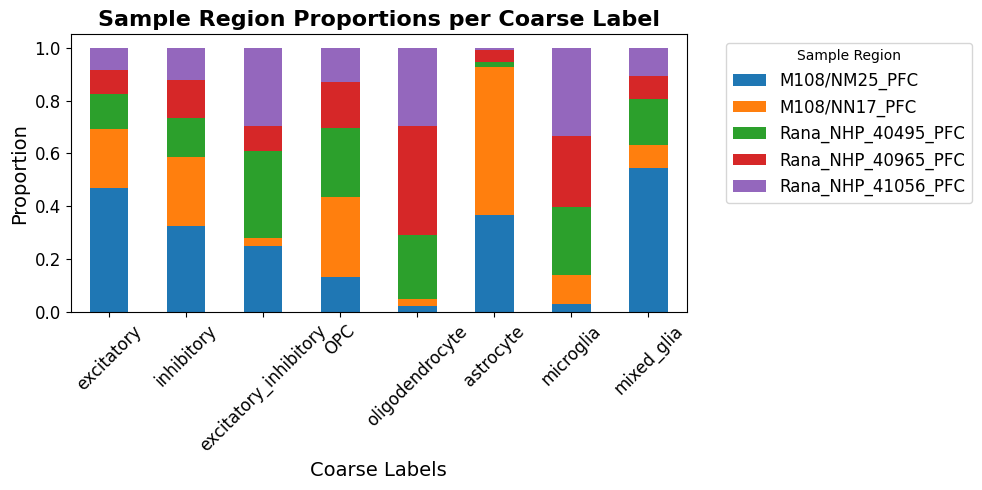

In [289]:
# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'excitatory_inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Calculate proportions and reorder rows based on `desired_order`
region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()
region_proportions = region_proportions.loc[desired_order]  # Reorder rows

# Stacked bar plot
region_proportions.plot(kind='bar', stacked=True, figsize=(10, 5), color=sns.color_palette("tab10"))
plt.title('Sample Region Proportions per Coarse Label', fontsize=16, weight='bold')
plt.ylabel('Proportion', fontsize=14)
plt.xlabel('Coarse Labels', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sample Region', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/2924012262.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


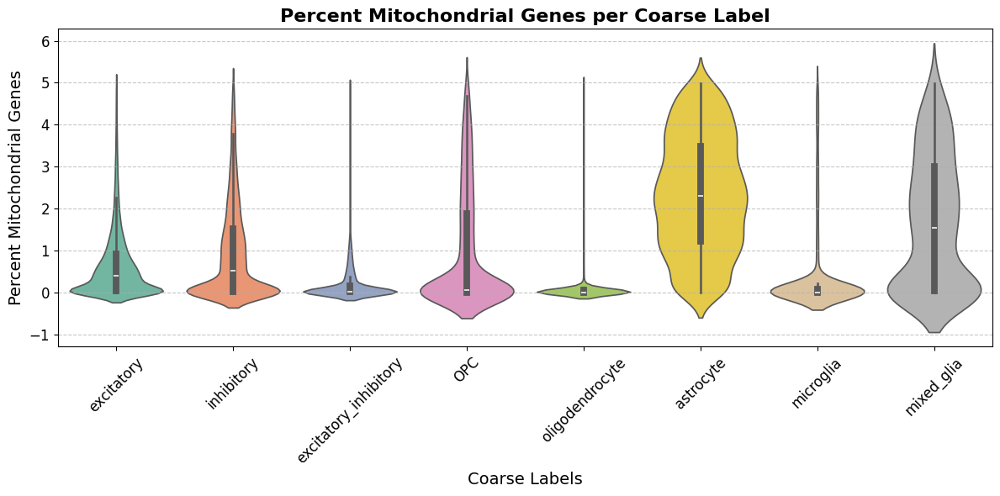

In [291]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'excitatory_inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for percent mitochondrial genes
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='percent_mito',
    order=desired_order,  # Use desired order
    palette=palette  # Add colors
)

# Improve plot aesthetics
plt.title('Percent Mitochondrial Genes per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Percent Mitochondrial Genes', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


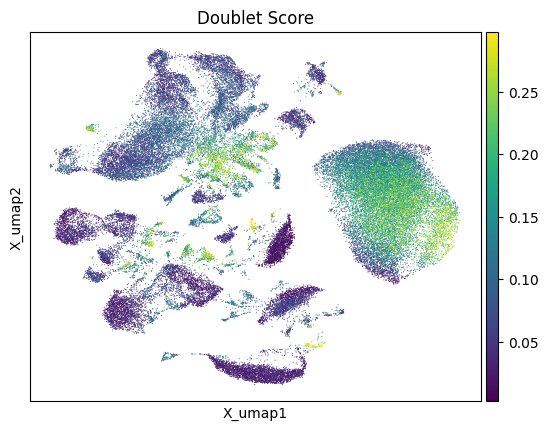

In [10]:
sc.pl.embedding(data, basis = 'X_umap', color = 'Doublet Score')
plt.show()

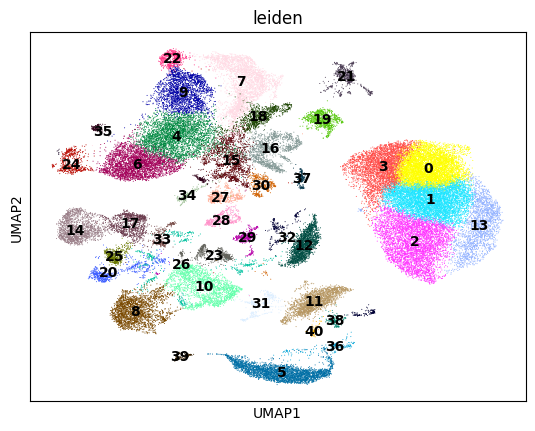

In [5]:
sc.pl.umap(data, color = 'leiden', legend_loc = 'on data')

In [7]:
sc.tl.rank_genes_groups(
    data, groupby="leiden", method="wilcoxon", key_added="dea_leiden"
)

/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:

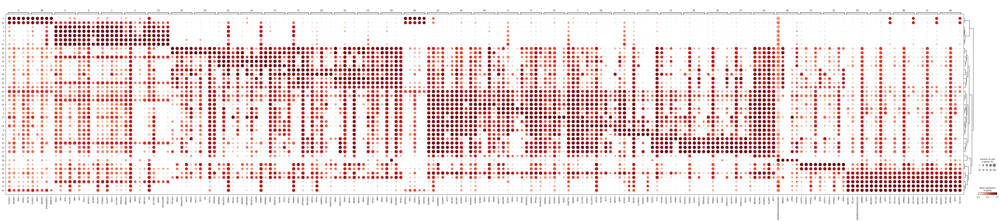

In [8]:
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden", standard_scale="var", n_genes=5, key="dea_leiden"
)

In [9]:
sc.tl.filter_rank_genes_groups(
    data,
    min_in_group_fraction=0.2,
    max_out_group_fraction=0.2,
    key="dea_leiden",
    key_added="dea_leiden_filtered",
)

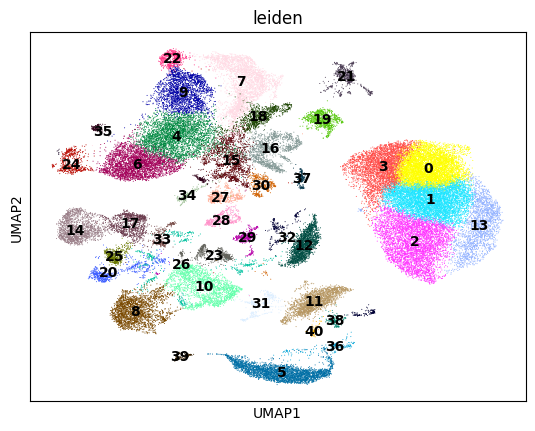

In [10]:
sc.pl.umap(data, color = 'leiden', legend_loc = 'on data')

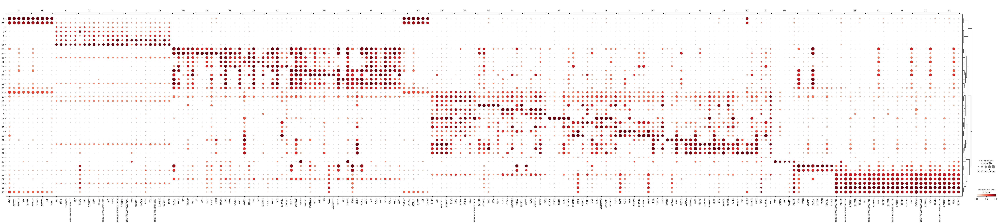

In [11]:
sc.pl.rank_genes_groups_dotplot(
    data,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_filtered",
)

In [12]:
marker_genes = ['DOCK8', 'MOBP', 'GFAP', 'RBFOX3', 'SLC17A6', 'GAD1', 'LHFPL3', 'COBLL1']

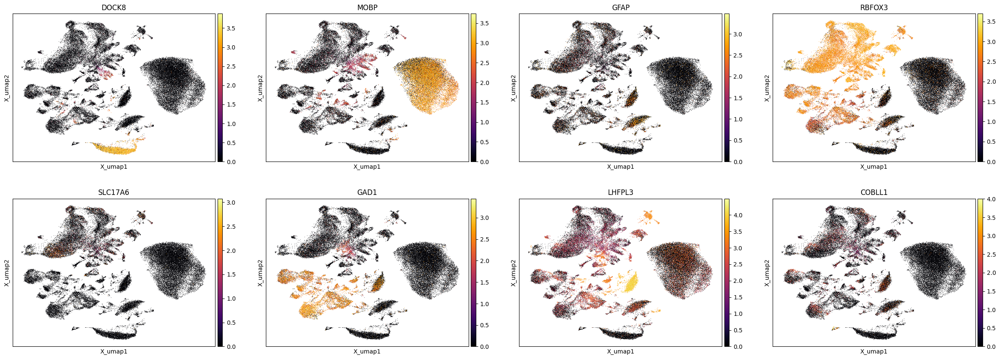

In [13]:
sc.pl.embedding(data, basis = 'X_umap', color = marker_genes, 
                use_raw = False, cmap = "inferno")

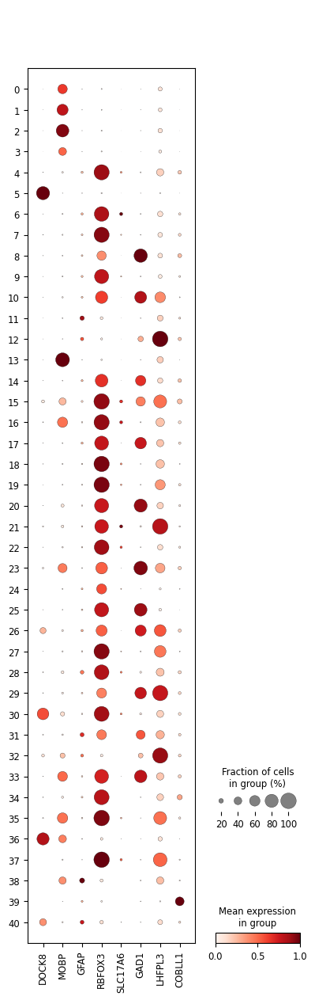

In [14]:
sc.pl.dotplot(data, var_names = marker_genes, groupby = 'leiden', standard_scale = 'var')

## Amygdala:

In [294]:
data = sc.read_h5ad("/cndd/xic007/scorch/SCORCH_NHP/Processed_h5ad/RNA_241202_NHP_Amygdala_2samples_normalized_doublet_22311cells.h5ad")

In [16]:
data.obs

,Sample_id,Condition,Brain Region,Doublet Score,Predicted Doublet,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,...,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,percent_mito,percent_ribo,n_genes,Sample_region,leiden
M108/NN17_Amygdala_AAACAGCCAAGTTATC-1,M108/NN17,Control,Amygdala,0.108911,False,3306,8.103797,7900.0,8.974745,15.316456,...,5.056246,1.974684,66.0,4.204693,0.835443,1.974684,0.835443,3296,M108/NN17_Amygdala,22
M108/NN17_Amygdala_AAACAGCCAATCTCTC-1,M108/NN17,Control,Amygdala,0.116981,False,1176,7.070724,2032.0,7.617268,25.836614,...,4.406719,3.986220,30.0,3.433987,1.476378,3.986220,1.476378,1169,M108/NN17_Amygdala,0
M108/NN17_Amygdala_AAACAGCCAATTGAAG-1,M108/NN17,Control,Amygdala,0.040512,False,5739,8.655214,31448.0,10.356122,23.540448,...,4.905275,0.426100,85.0,4.454347,0.270287,0.426100,0.270287,5732,M108/NN17_Amygdala,7
M108/NN17_Amygdala_AAACAGCCACAAAGGT-1,M108/NN17,Control,Amygdala,0.099237,False,4236,8.351611,15350.0,9.638936,22.638436,...,4.605170,0.644951,56.0,4.043051,0.364821,0.644951,0.364821,4228,M108/NN17_Amygdala,4
M108/NN17_Amygdala_AAACAGCCACTTAGGC-1,M108/NN17,Control,Amygdala,0.011287,False,3319,8.107720,8953.0,9.099855,21.143751,...,4.369448,0.871216,44.0,3.806663,0.491455,0.871216,0.491455,3312,M108/NN17_Amygdala,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M108/NM25_Amygdala_TTTGTGTTCTGTTGCC-1,M108/NM25,Control,Amygdala,0.091183,False,5266,8.569216,21371.0,9.969837,20.448271,...,3.610918,0.168453,61.0,4.127134,0.285434,0.168453,0.285434,5260,M108/NM25_Amygdala,7
M108/NM25_Amygdala_TTTGTGTTCTTAGGAC-1,M108/NM25,Control,Amygdala,0.091183,False,1451,7.280697,2980.0,8.000014,24.261745,...,3.401197,0.973154,23.0,3.178054,0.771812,0.973154,0.771812,1444,M108/NM25_Amygdala,12
M108/NM25_Amygdala_TTTGTGTTCTTGTTCG-1,M108/NM25,Control,Amygdala,0.026609,False,2311,7.745868,5124.0,8.541885,23.106948,...,3.091043,0.409836,24.0,3.218876,0.468384,0.409836,0.468384,2304,M108/NM25_Amygdala,10
M108/NM25_Amygdala_TTTGTTGGTAAGGTCC-1,M108/NM25,Control,Amygdala,0.072655,False,5242,8.564649,21141.0,9.959017,20.405846,...,2.995732,0.089873,73.0,4.304065,0.345301,0.089873,0.345301,5235,M108/NM25_Amygdala,7


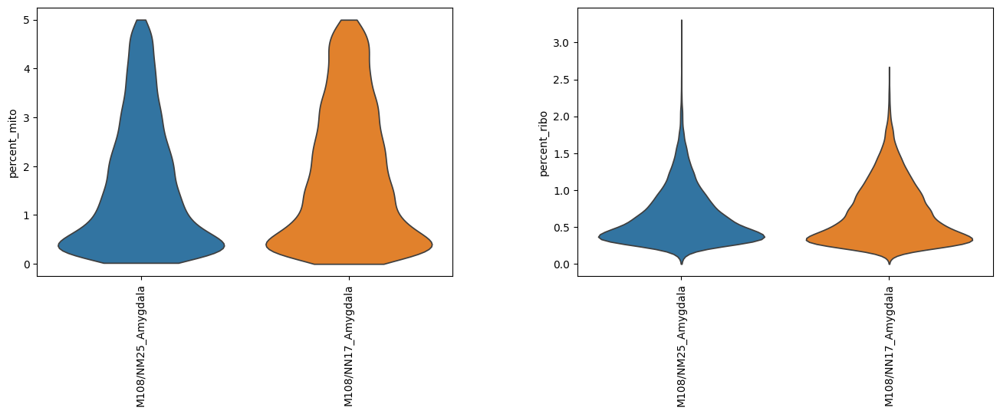

In [17]:
sc.pl.violin(data, ['percent_mito','percent_ribo'], stripplot = False,
             jitter=0.4, groupby = "Sample_region", rotation=90)
plt.show()

In [295]:
#PFC marker genes -> update these from papers
pfc_genes = {
    'excitatory_neuron': ['SLC17A6', 'SLC17A7', 'NEUROD2', 'NEUROD6'],
    'inhibitory_neuron': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
    'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
    'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
    'OPC': ['SOX10', 'OLIG2'],
    'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}

excitatory


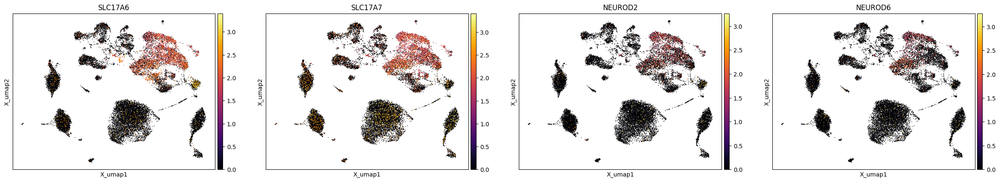

inhibitory


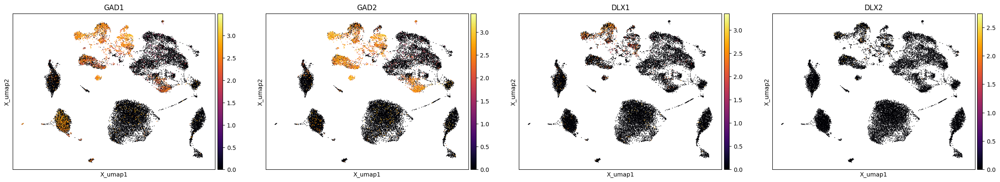

opc


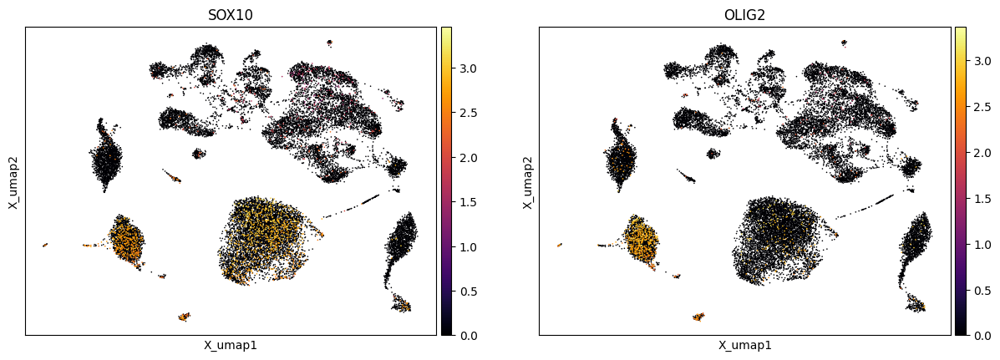

oligodendrocyte


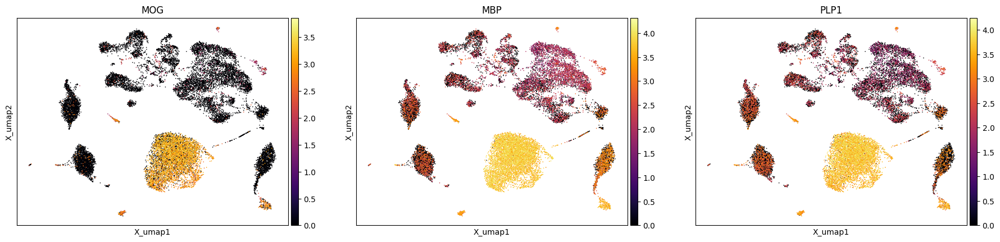

astrocyte


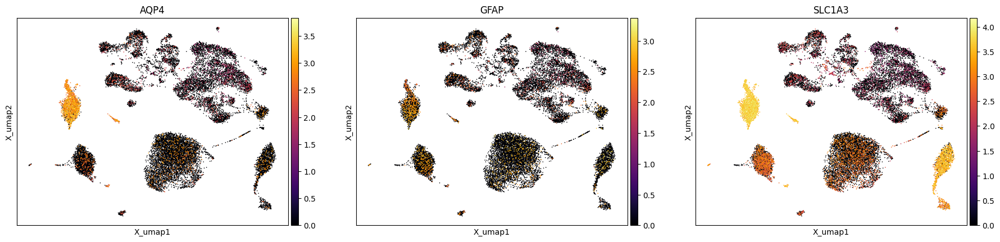

microglia


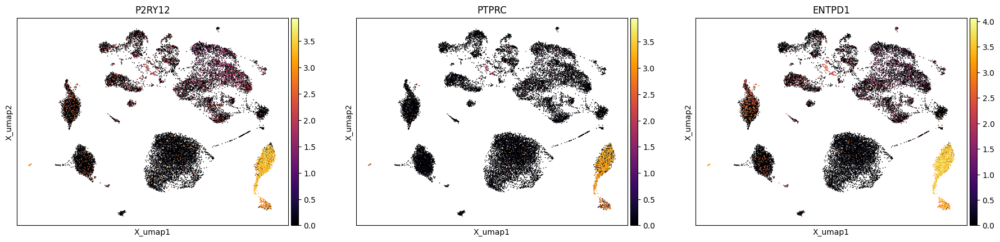

In [296]:


print('excitatory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['excitatory_neuron'], 
                use_raw = False, cmap = "inferno")
print('inhibitory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['inhibitory_neuron'], 
                use_raw = False, cmap = "inferno")

print('opc')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['OPC'], 
                use_raw = False, cmap = "inferno")

print('oligodendrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['oligodendrocyte'], 
                use_raw = False, cmap = "inferno")

print('astrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['astrocyte'], 
                use_raw = False, cmap = "inferno")

print('microglia')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['microglia'], 
                use_raw = False, cmap = "inferno")

In [297]:
pfc_genes = {
    'excitatory_neuron': ['SLC17A7'],
    'inhibitory_neuron': ['GAD1'],
    'oligodendrocyte': ['MOG'],
    'astrocyte': ['AQP4'],
    'OPC': ['OLIG2'],
    'microglia': ['PTPRC']}

#allocate coarse labels based on mean expression
emp = np.full(data.obs.shape[0], 'undefined', dtype=object)
leid = np.asarray(data.obs['leiden'].values)

#neurons first
thresh = 0.7
for key in list(pfc_genes.keys())[:2]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]
            else:
                # If key not already in the label, append it
                if key not in current_label.split('_'):
                    emp[cluster_mask] = 'excitatory_inhibitory' #current_label + '_' + key[:4]

#glia
thresh = 0.5
for key in list(pfc_genes.keys())[2:]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]

            elif pd.Series(current_label).str.contains('exci|inh')[0] == False:
                emp[cluster_mask] = 'mixed_glia' #current_label + '_' + key[:4]


# Assign coarse labels to the data object
data.obs['coarse_labels'] = emp

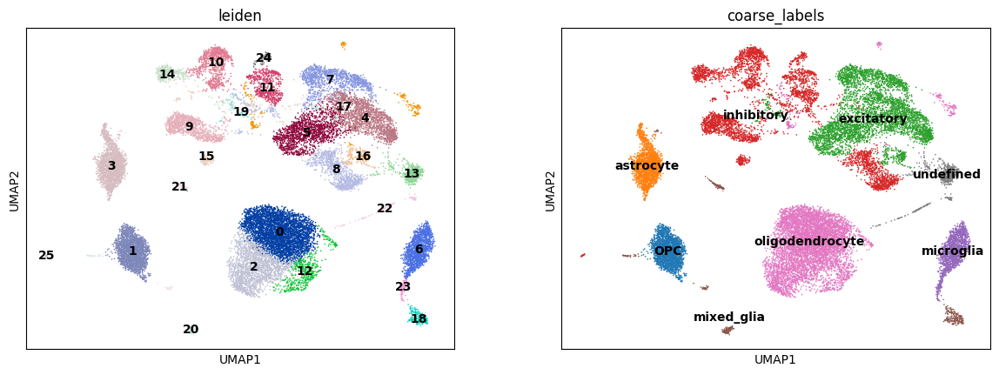

In [298]:
#UMAP labels
sc.pl.umap(data, color = ['leiden', 'coarse_labels'], legend_loc = 'on data')

/tmp/ipykernel_54735/2154570947.py:17: FutureWarning: The behavior of Series.argsort in the presence of NA values is deprecated. In a future version, NA values will be ordered last instead of set to -1.
  fdata = fdata[fdata.obs['coarse_labels'].argsort()]


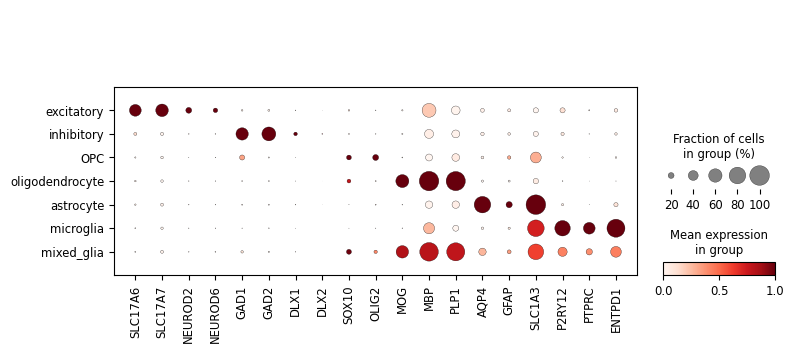

In [304]:
_genes = {
    'excitatory': ['SLC17A6', 'SLC17A7', 'NEUROD2', 'NEUROD6'],
    'inhibitory': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
    'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
    'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
    'OPC': ['SOX10', 'OLIG2'],
    'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}

# Define the desired order for coarse_labels: neurons first, then glia
desired_order = ['excitatory', 'inhibitory','OPC', 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Reorder `coarse_labels` in the dataset
fdata = data.copy()
fdata.obs['coarse_labels'] = pd.Categorical(fdata.obs['coarse_labels'], categories=desired_order, ordered=True)

# Sort the dataset by the new coarse_labels order
fdata = fdata[fdata.obs['coarse_labels'].argsort()]


# Flatten and reorder genes from pfc_genes based on `desired_order`
ordered_genes = []
for label in desired_order:
    if label in _genes:
        ordered_genes.extend(_genes[label])

# Plot the dot plot
sc.pl.dotplot(fdata, var_names=ordered_genes, groupby='coarse_labels', standard_scale='var')



/tmp/ipykernel_54735/2899207404.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


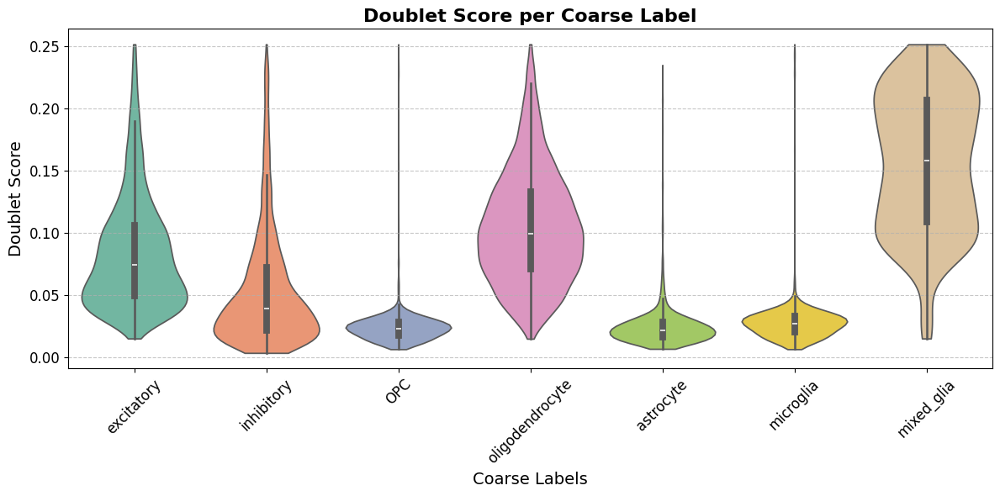

In [300]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for doublet scores with custom colors
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='Doublet Score',
    order=desired_order,  # Use the desired order
    palette=palette,  # Add colors
    cut=0  # Restrict violins to the range of the data
)

# Improve plot aesthetics
plt.title('Doublet Score per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Doublet Score', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/1086604707.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()


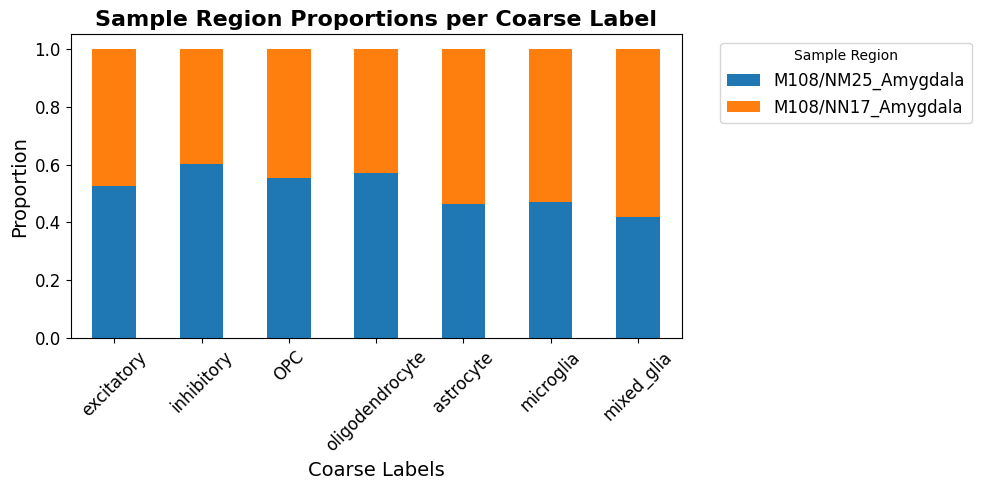

In [301]:
# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Calculate proportions and reorder rows based on `desired_order`
region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()
region_proportions = region_proportions.loc[desired_order]  # Reorder rows

# Stacked bar plot
region_proportions.plot(kind='bar', stacked=True, figsize=(10, 5), color=sns.color_palette("tab10"))
plt.title('Sample Region Proportions per Coarse Label', fontsize=16, weight='bold')
plt.ylabel('Proportion', fontsize=14)
plt.xlabel('Coarse Labels', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sample Region', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/2877546525.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


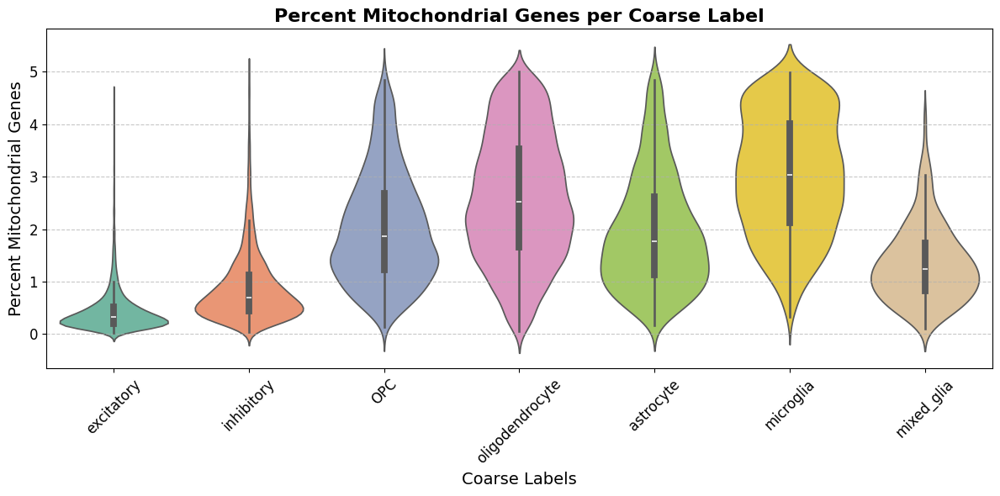

In [303]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for percent mitochondrial genes
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='percent_mito',
    order=desired_order,  # Use desired order
    palette=palette  # Add colors
)

# Improve plot aesthetics
plt.title('Percent Mitochondrial Genes per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Percent Mitochondrial Genes', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


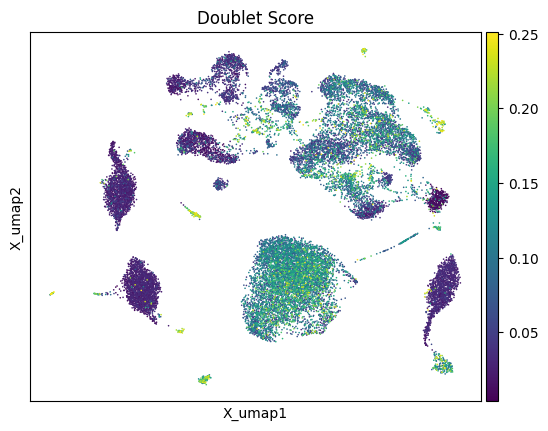

In [18]:
sc.pl.embedding(data, basis = 'X_umap', color = 'Doublet Score')
plt.show()

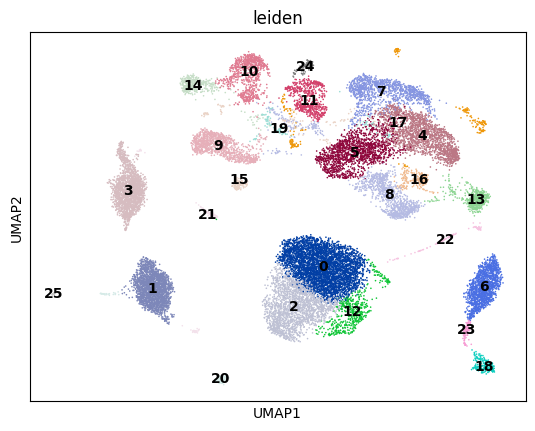

In [19]:
sc.pl.umap(data, color = 'leiden', legend_loc = 'on data')

In [20]:
sc.tl.rank_genes_groups(
    data, groupby="leiden", method="wilcoxon", key_added="dea_leiden"
)

/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:

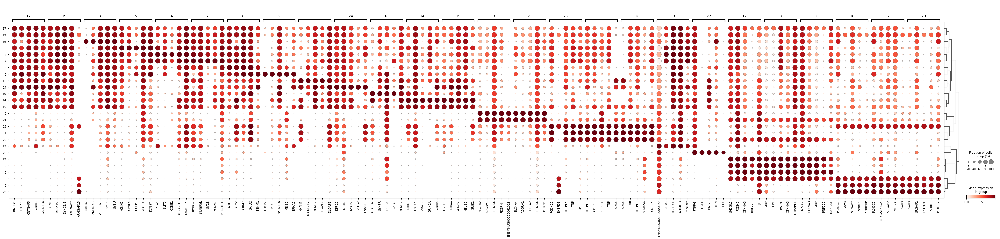

In [21]:
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden", standard_scale="var", n_genes=5, key="dea_leiden"
)

In [22]:
sc.tl.filter_rank_genes_groups(
    data,
    min_in_group_fraction=0.2,
    max_out_group_fraction=0.2,
    key="dea_leiden",
    key_added="dea_leiden_filtered",
)

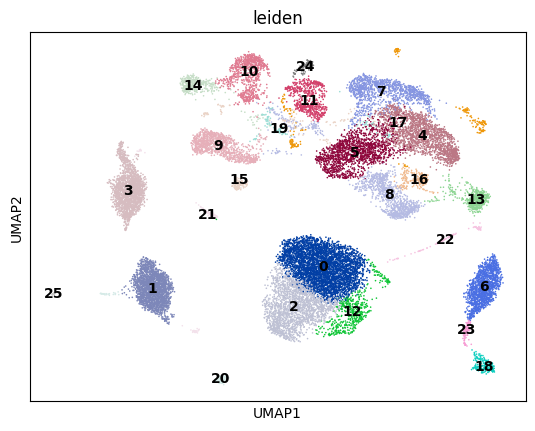

In [23]:
sc.pl.umap(data, color = 'leiden', legend_loc = 'on data')

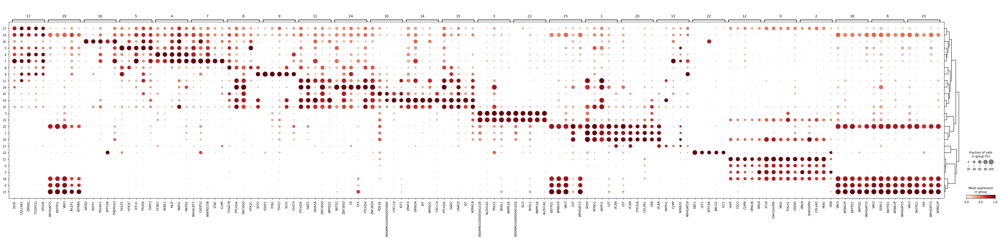

In [24]:
sc.pl.rank_genes_groups_dotplot(
    data,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_filtered",
)

In [25]:
marker_genes = ['DOCK8', 'MOBP', 'GFAP', 'RBFOX3', 'SLC17A6', 'GAD1', 'LHFPL3', 'COBLL1']

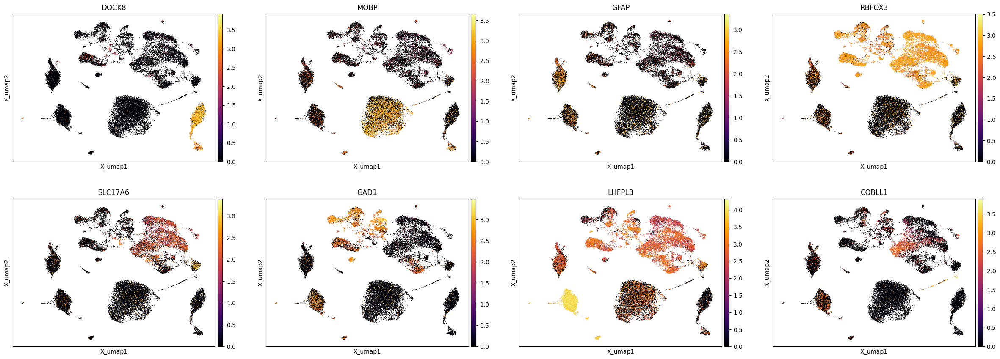

In [26]:
sc.pl.embedding(data, basis = 'X_umap', color = marker_genes, 
                use_raw = False, cmap = "inferno")

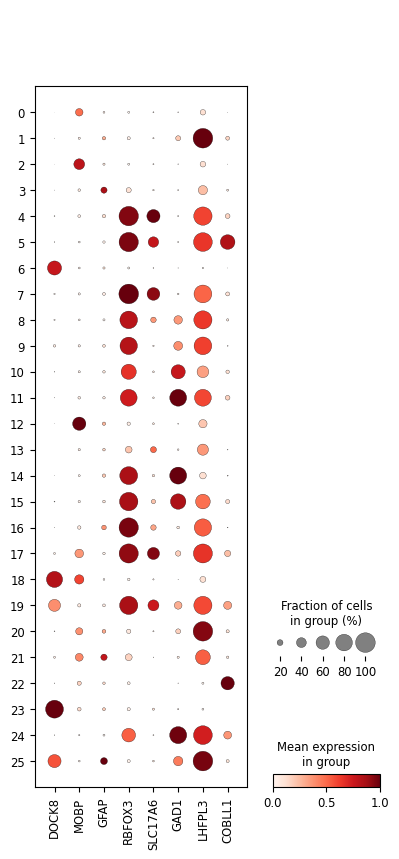

In [27]:
sc.pl.dotplot(data, var_names = marker_genes, groupby = 'leiden', standard_scale = 'var')

## Hippocampus:

In [305]:
data = sc.read_h5ad("/cndd/xic007/scorch/SCORCH_NHP/Processed_h5ad/RNA_241202_NHP_Hippocampus_2samples_normalized_doublet_23073cells.h5ad")

In [29]:
data.obs

,Sample_id,Condition,Brain Region,Doublet Score,Predicted Doublet,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,...,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,percent_mito,percent_ribo,n_genes,Sample_region,leiden
MM108/NN17_Hippocampus_AAACAGCCAAGGTACG-1,MM108/NN17,Control,Hippocampus,0.017921,False,1736,7.459915,3089.0,8.035927,21.495630,...,4.844187,4.078990,42.0,3.761200,1.359663,4.078990,1.359663,1729,MM108/NN17_Hippocampus,4
MM108/NN17_Hippocampus_AAACAGCCAATTATGC-1,MM108/NN17,Control,Hippocampus,0.040000,False,1121,7.022868,1823.0,7.508787,22.764674,...,3.784190,2.358749,4.0,1.609438,0.219419,2.358749,0.219419,1115,MM108/NN17_Hippocampus,3
MM108/NN17_Hippocampus_AAACAGCCAATTTAGC-1,MM108/NN17,Control,Hippocampus,0.287770,False,2390,7.779467,5248.0,8.565793,21.703506,...,5.075174,3.029726,48.0,3.891820,0.914634,3.029726,0.914634,2382,MM108/NN17_Hippocampus,19
MM108/NN17_Hippocampus_AAACAGCCAGCAAATA-1,MM108/NN17,Control,Hippocampus,0.015408,False,1461,7.287561,2572.0,7.852828,23.017107,...,3.496508,1.244168,21.0,3.091043,0.816485,1.244168,0.816485,1454,MM108/NN17_Hippocampus,2
MM108/NN17_Hippocampus_AAACATGCAAGCTAAA-1,MM108/NN17,Control,Hippocampus,0.020610,False,987,6.895683,1469.0,7.293018,20.285909,...,3.637586,2.518720,17.0,2.890372,1.157250,2.518720,1.157250,981,MM108/NN17_Hippocampus,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M108/NM25_Hippocampus_TTTGTGTTCGTAATCA-1,M108/NM25,Control,Hippocampus,0.008376,False,1364,7.218910,2406.0,7.786137,23.607648,...,3.761200,1.745636,16.0,2.833213,0.665004,1.745636,0.665004,1357,M108/NM25_Hippocampus,2
M108/NM25_Hippocampus_TTTGTGTTCTCCTCTT-1,M108/NM25,Control,Hippocampus,0.035135,False,3767,8.234300,12599.0,9.441452,19.207874,...,4.077538,0.460354,35.0,3.583519,0.277800,0.460354,0.277800,3760,M108/NM25_Hippocampus,8
M108/NM25_Hippocampus_TTTGTTGGTCAATACG-1,M108/NM25,Control,Hippocampus,0.105678,False,920,6.825460,1284.0,7.158514,20.327103,...,4.174387,4.984424,26.0,3.295837,2.024922,4.984424,2.024922,913,M108/NM25_Hippocampus,25
M108/NM25_Hippocampus_TTTGTTGGTTAATCGG-1,M108/NM25,Control,Hippocampus,0.052128,False,4893,8.495765,17932.0,9.794398,18.062681,...,4.499810,0.496319,52.0,3.970292,0.289984,0.496319,0.289984,4885,M108/NM25_Hippocampus,37


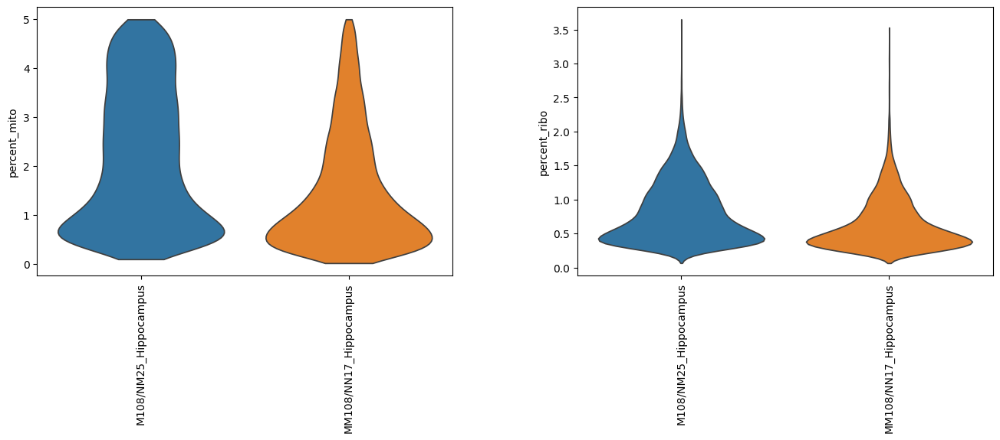

In [30]:
sc.pl.violin(data, ['percent_mito','percent_ribo'], stripplot = False,
             jitter=0.4, groupby = "Sample_region", rotation=90)
plt.show()

excitatory


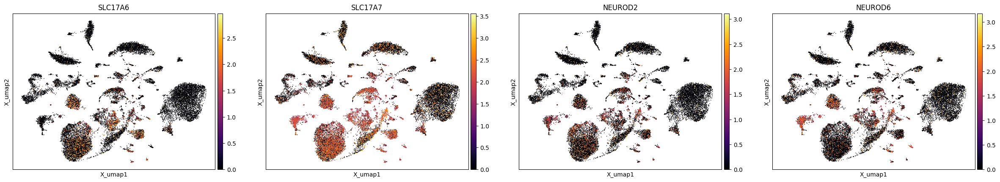

inhibitory


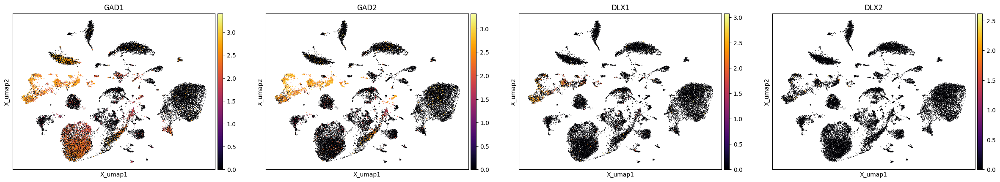

opc


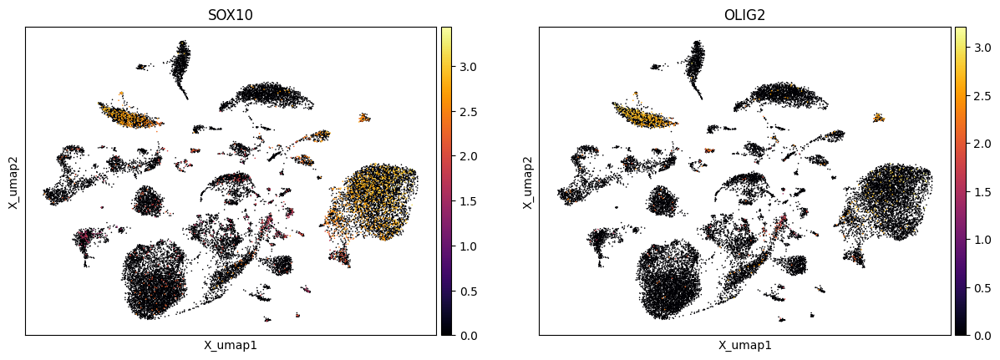

oligodendrocyte


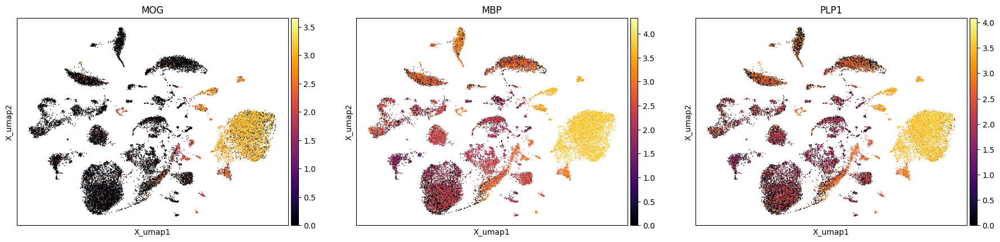

astrocyte


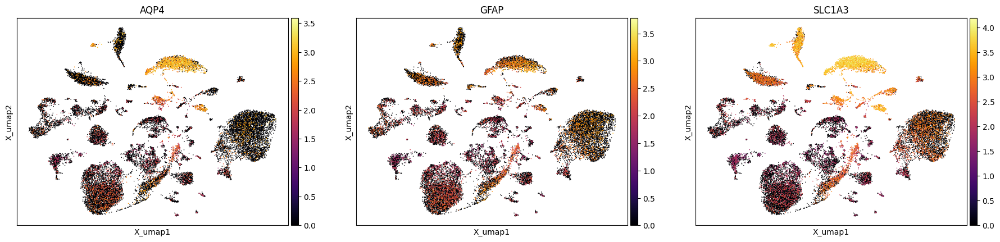

microglia


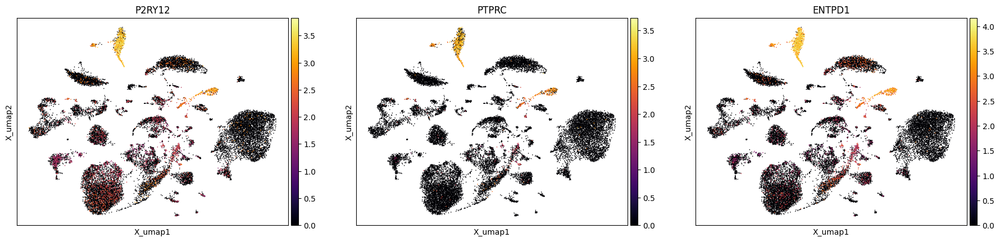

In [306]:
#PFC marker genes -> update these from papers
pfc_genes = {
    'excitatory_neuron': ['SLC17A6', 'SLC17A7', 'NEUROD2', 'NEUROD6'],
    'inhibitory_neuron': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
    'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
    'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
    'OPC': ['SOX10', 'OLIG2'],
    'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}

print('excitatory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['excitatory_neuron'], 
                use_raw = False, cmap = "inferno")
print('inhibitory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['inhibitory_neuron'], 
                use_raw = False, cmap = "inferno")

print('opc')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['OPC'], 
                use_raw = False, cmap = "inferno")

print('oligodendrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['oligodendrocyte'], 
                use_raw = False, cmap = "inferno")

print('astrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['astrocyte'], 
                use_raw = False, cmap = "inferno")

print('microglia')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['microglia'], 
                use_raw = False, cmap = "inferno")

In [307]:
pfc_genes = {
    'excitatory_neuron': ['SLC17A7'],
    'inhibitory_neuron': ['GAD1'],
    'oligodendrocyte': ['MOG'],
    'astrocyte': ['AQP4'],
    'OPC': ['OLIG2'],
    'microglia': ['PTPRC']}

#allocate coarse labels based on mean expression
emp = np.full(data.obs.shape[0], 'undefined', dtype=object)
leid = np.asarray(data.obs['leiden'].values)

#neurons first
thresh = 0.7
for key in list(pfc_genes.keys())[:2]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]
            else:
                # If key not already in the label, append it
                if key not in current_label.split('_'):
                    emp[cluster_mask] = 'excitatory_inhibitory' #current_label + '_' + key[:4]

#glia
thresh = 0.5
for key in list(pfc_genes.keys())[2:]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]

            elif pd.Series(current_label).str.contains('exci|inh')[0] == False:
                emp[cluster_mask] = 'mixed_glia' #current_label + '_' + key[:4]


# Assign coarse labels to the data object
data.obs['coarse_labels'] = emp

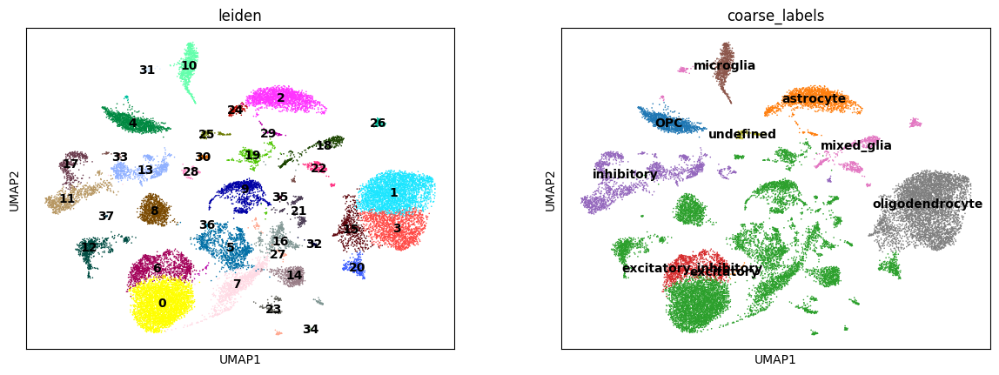

In [308]:
#UMAP labels
sc.pl.umap(data, color = ['leiden', 'coarse_labels'], legend_loc = 'on data')

/tmp/ipykernel_54735/2822897773.py:17: FutureWarning: The behavior of Series.argsort in the presence of NA values is deprecated. In a future version, NA values will be ordered last instead of set to -1.
  fdata = fdata[fdata.obs['coarse_labels'].argsort()]


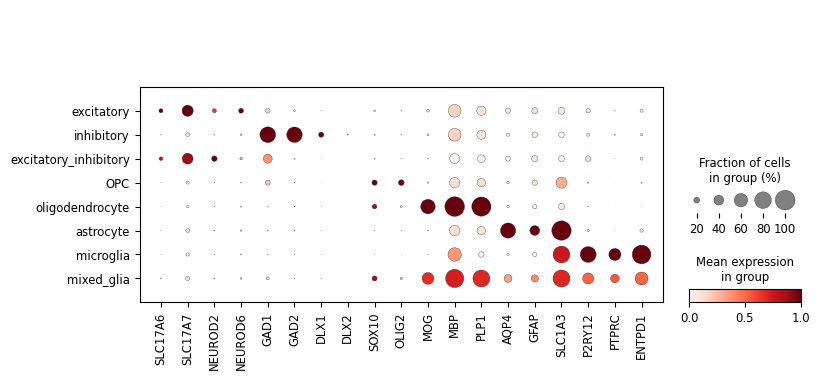

In [310]:
_genes = {
    'excitatory': ['SLC17A6', 'SLC17A7', 'NEUROD2', 'NEUROD6'],
    'inhibitory': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
    'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
    'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
    'OPC': ['SOX10', 'OLIG2'],
    'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}

# Define the desired order for coarse_labels: neurons first, then glia
desired_order = ['excitatory', 'inhibitory', 'excitatory_inhibitory','OPC', 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Reorder `coarse_labels` in the dataset
fdata = data.copy()
fdata.obs['coarse_labels'] = pd.Categorical(fdata.obs['coarse_labels'], categories=desired_order, ordered=True)

# Sort the dataset by the new coarse_labels order
fdata = fdata[fdata.obs['coarse_labels'].argsort()]


# Flatten and reorder genes from pfc_genes based on `desired_order`
ordered_genes = []
for label in desired_order:
    if label in _genes:
        ordered_genes.extend(_genes[label])

# Plot the dot plot
sc.pl.dotplot(fdata, var_names=ordered_genes, groupby='coarse_labels', standard_scale='var')



/tmp/ipykernel_54735/903295940.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


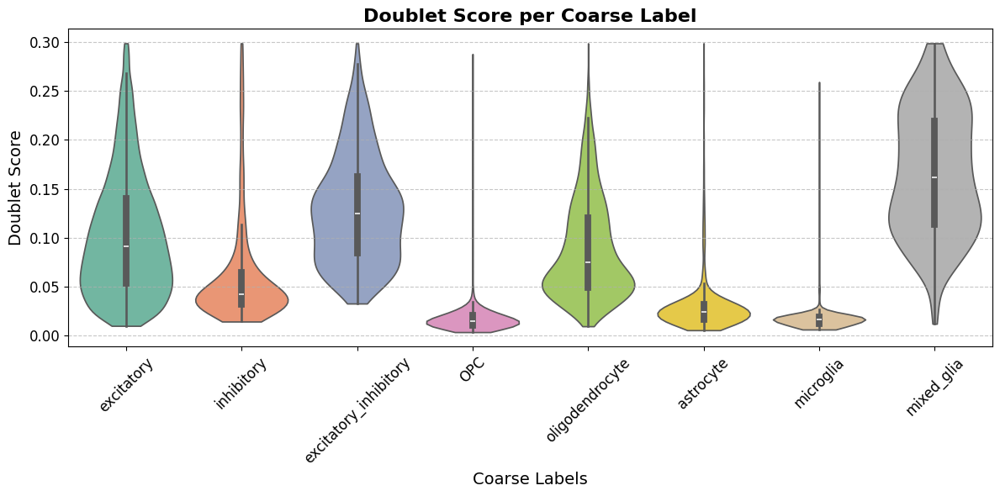

In [313]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'excitatory_inhibitory', 'OPC',
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for doublet scores with custom colors
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='Doublet Score',
    order=desired_order,  # Use the desired order
    palette=palette,  # Add colors
    cut=0  # Restrict violins to the range of the data
)

# Improve plot aesthetics
plt.title('Doublet Score per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Doublet Score', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/163540896.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()


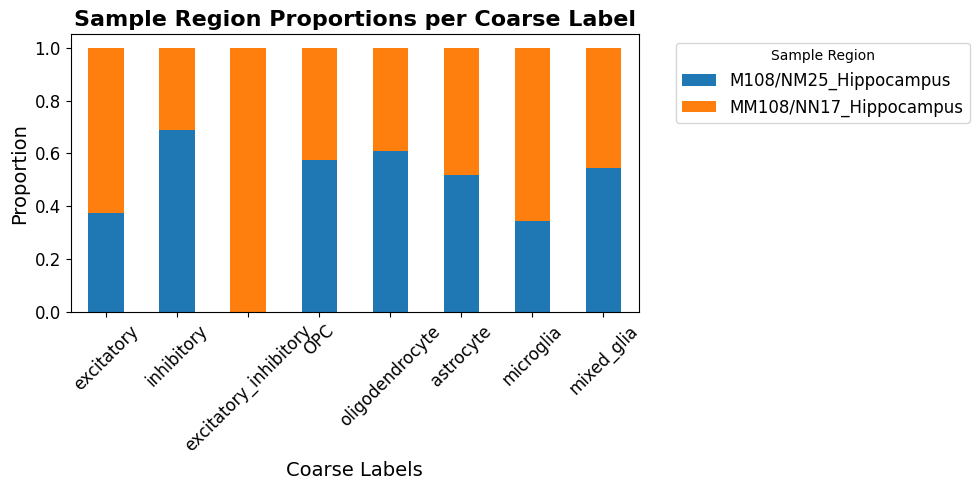

In [312]:
# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory', 'excitatory_inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Calculate proportions and reorder rows based on `desired_order`
region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()
region_proportions = region_proportions.loc[desired_order]  # Reorder rows

# Stacked bar plot
region_proportions.plot(kind='bar', stacked=True, figsize=(10, 5), color=sns.color_palette("tab10"))
plt.title('Sample Region Proportions per Coarse Label', fontsize=16, weight='bold')
plt.ylabel('Proportion', fontsize=14)
plt.xlabel('Coarse Labels', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sample Region', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/1899088020.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


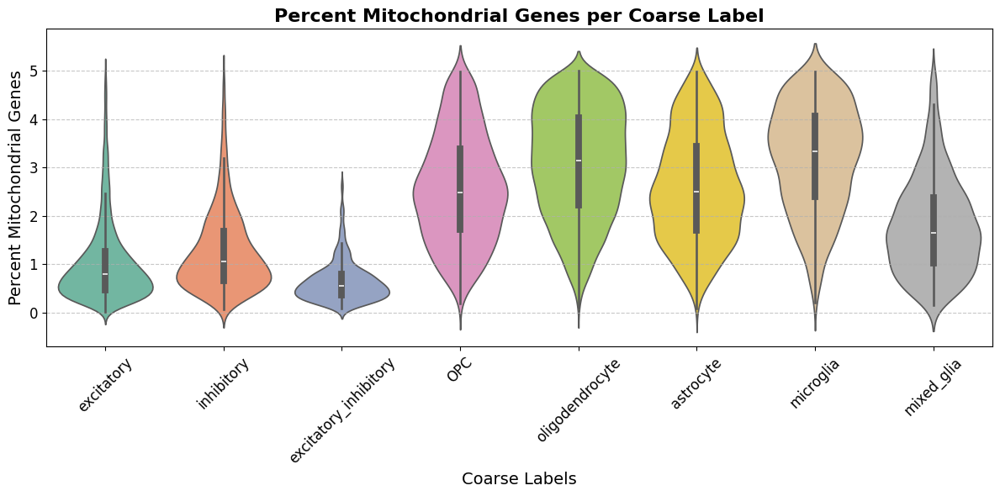

In [314]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the desired order for coarse_labels
desired_order = ['excitatory', 'inhibitory',  'excitatory_inhibitory', 'OPC', 
                 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for percent mitochondrial genes
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='percent_mito',
    order=desired_order,  # Use desired order
    palette=palette  # Add colors
)

# Improve plot aesthetics
plt.title('Percent Mitochondrial Genes per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Percent Mitochondrial Genes', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


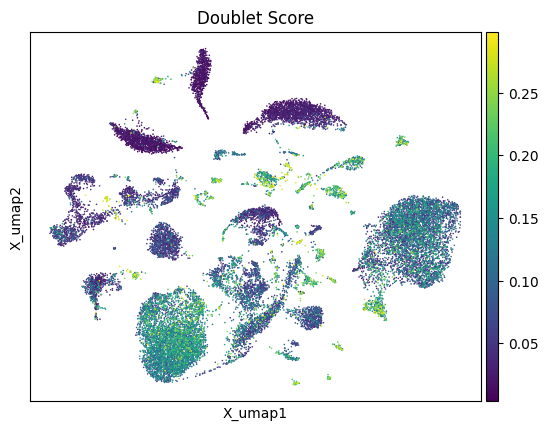

In [31]:
sc.pl.embedding(data, basis = 'X_umap', color = 'Doublet Score')
plt.show()

In [32]:
sc.tl.rank_genes_groups(
    data, groupby="leiden", method="wilcoxon", key_added="dea_leiden"
)

/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:

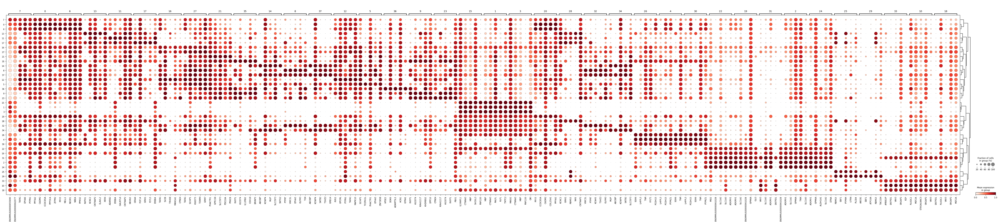

In [33]:
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden", standard_scale="var", n_genes=5, key="dea_leiden"
)

In [34]:
sc.tl.filter_rank_genes_groups(
    data,
    min_in_group_fraction=0.2,
    max_out_group_fraction=0.2,
    key="dea_leiden",
    key_added="dea_leiden_filtered",
)

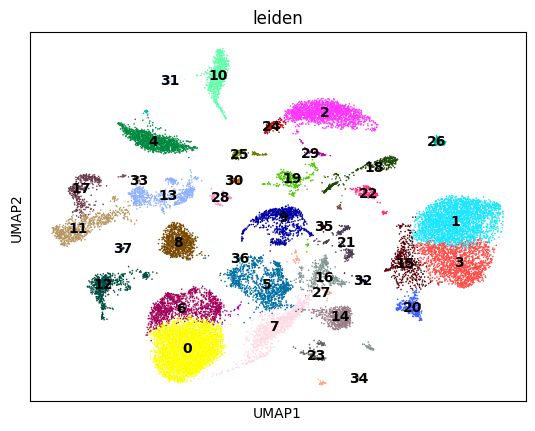

In [35]:
sc.pl.umap(data, color = 'leiden', legend_loc = 'on data')

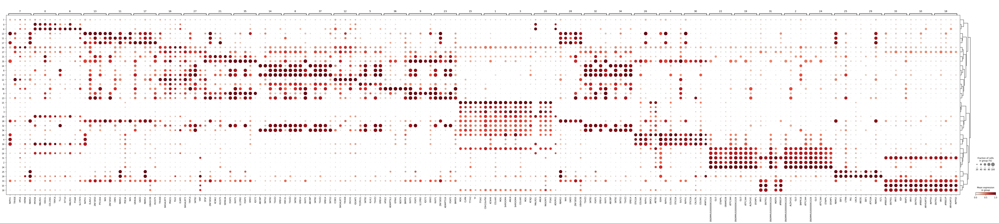

In [36]:
sc.pl.rank_genes_groups_dotplot(
    data,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_filtered",
)

In [37]:
marker_genes = ['DOCK8', 'MOBP', 'GFAP', 'RBFOX3', 'SLC17A6', 'GAD1', 'LHFPL3', 'COBLL1']

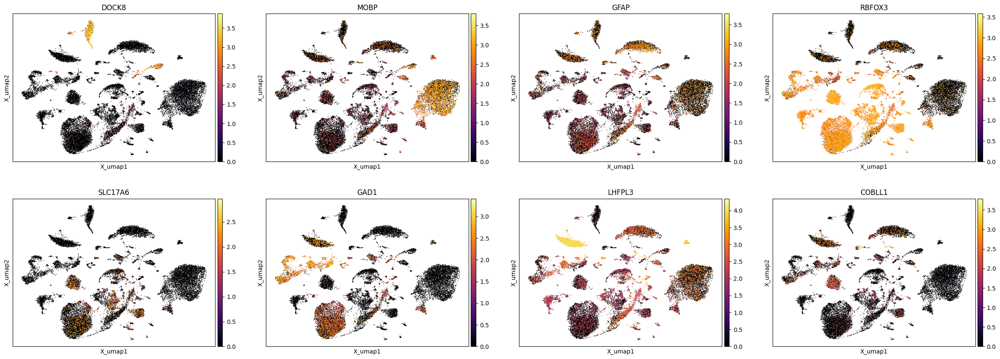

In [38]:
sc.pl.embedding(data, basis = 'X_umap', color = marker_genes, 
                use_raw = False, cmap = "inferno")

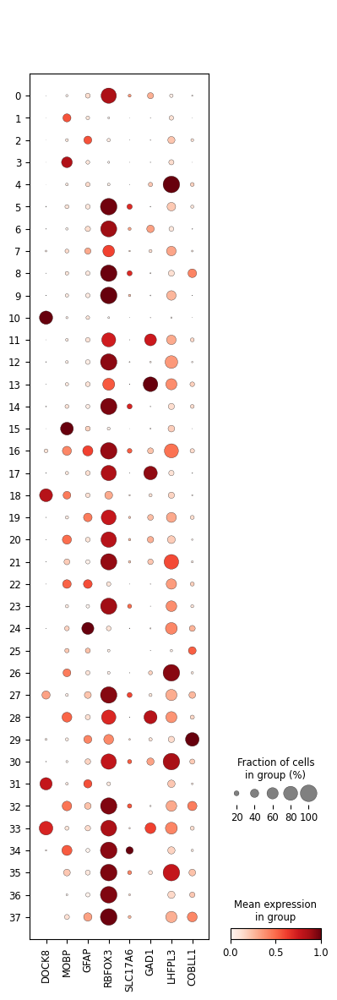

In [39]:
sc.pl.dotplot(data, var_names = marker_genes, groupby = 'leiden', standard_scale = 'var')

## Striatum:

In [315]:
data = sc.read_h5ad("/cndd/xic007/scorch/SCORCH_NHP/Processed_h5ad/RNA_241202_NHP_Striatum_1samples_normalized_doublet_6887cells.h5ad")

In [57]:
data.obs

,Sample_id,Condition,Brain Region,Doublet Score,Predicted Doublet,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,...,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,percent_mito,percent_ribo,n_genes,Sample_region,leiden
M108/NN17_Striatum_AAACAGCCAAAGCGCA-1,M108/NN17,Control,Striatum,0.185401,False,5109,8.538955,23186.0,10.051347,20.943673,...,5.537334,1.091176,87.0,4.477337,0.375226,1.091176,0.375226,5100,M108/NN17_Striatum,4
M108/NN17_Striatum_AAACAGCCAGGAACCA-1,M108/NN17,Control,Striatum,0.025797,False,4313,8.369621,16539.0,9.713537,22.994135,...,5.908083,2.218997,95.0,4.564348,0.574400,2.218997,0.574400,4304,M108/NN17_Striatum,8
M108/NN17_Striatum_AAACAGCCATTGCGAC-1,M108/NN17,Control,Striatum,0.089618,False,4198,8.342602,17864.0,9.790599,24.680923,...,5.176150,0.985222,52.0,3.970292,0.291088,0.985222,0.291088,4191,M108/NN17_Striatum,0
M108/NN17_Striatum_AAACATGCAACACCTA-1,M108/NN17,Control,Striatum,0.158442,False,4702,8.455956,22694.0,10.029900,21.582797,...,5.501258,1.075174,102.0,4.634729,0.449458,1.075174,0.449458,4692,M108/NN17_Striatum,1
M108/NN17_Striatum_AAACATGCAAGTGAAC-1,M108/NN17,Control,Striatum,0.109990,False,3153,8.056427,7558.0,8.930494,20.071447,...,5.707110,3.969304,62.0,4.143135,0.820323,3.969304,0.820323,3144,M108/NN17_Striatum,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M108/NN17_Striatum_TTTGTGTTCGAGGAGT-1,M108/NN17,Control,Striatum,0.081172,False,3510,8.163656,11865.0,9.381433,21.879477,...,3.970292,0.438264,27.0,3.332205,0.227560,0.438264,0.227560,3503,M108/NN17_Striatum,4
M108/NN17_Striatum_TTTGTTGGTAACCACA-1,M108/NN17,Control,Striatum,0.047801,False,3479,8.154788,11335.0,9.335739,22.911337,...,4.094345,0.520512,36.0,3.610918,0.317600,0.520512,0.317600,3471,M108/NN17_Striatum,5
M108/NN17_Striatum_TTTGTTGGTACTGAAT-1,M108/NN17,Control,Striatum,0.019096,False,2000,7.601402,4532.0,8.419139,25.419241,...,4.867535,2.846425,27.0,3.332205,0.595763,2.846425,0.595763,1992,M108/NN17_Striatum,3
M108/NN17_Striatum_TTTGTTGGTTTACCGT-1,M108/NN17,Control,Striatum,0.053908,False,1812,7.502738,3730.0,8.224432,25.737265,...,5.129899,4.504022,26.0,3.295837,0.697051,4.504022,0.697051,1803,M108/NN17_Striatum,3


In [ ]:
Direct Pathway: DRD1, TAC1, GPR6.
Indirect Pathway: DRD2, PENK, ADORA2A.

excitatory


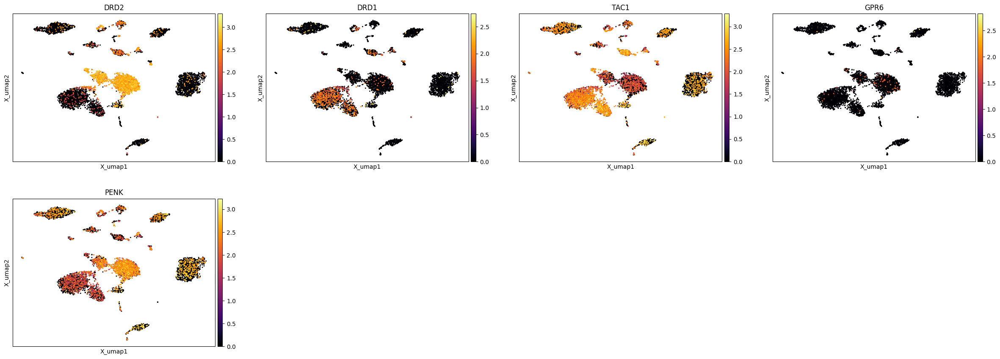

inhibitory


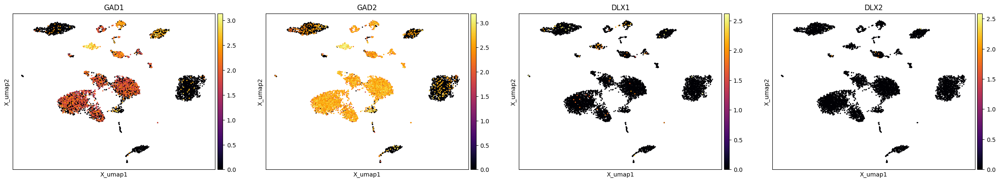

opc


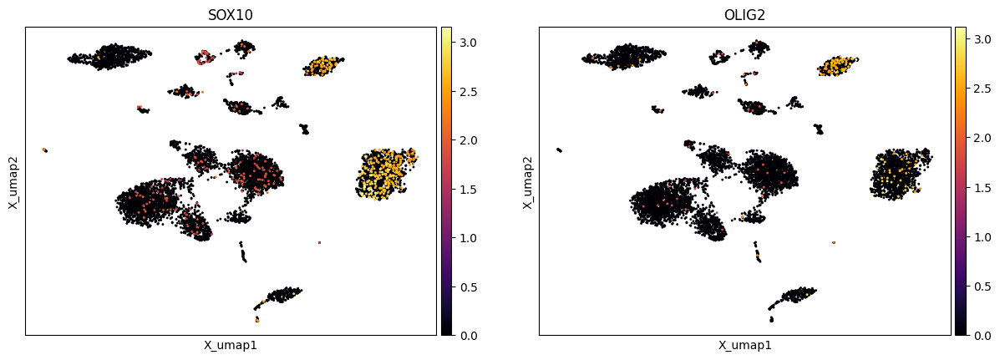

oligodendrocyte


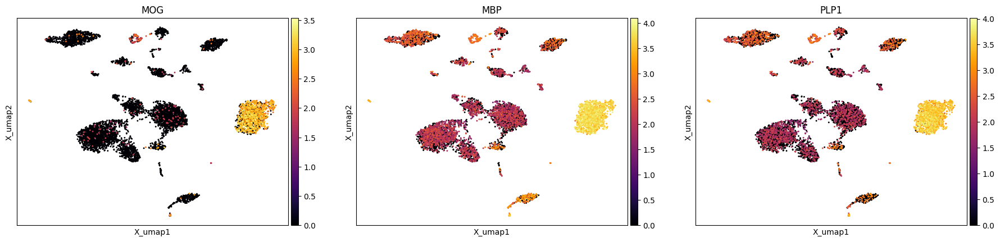

astrocyte


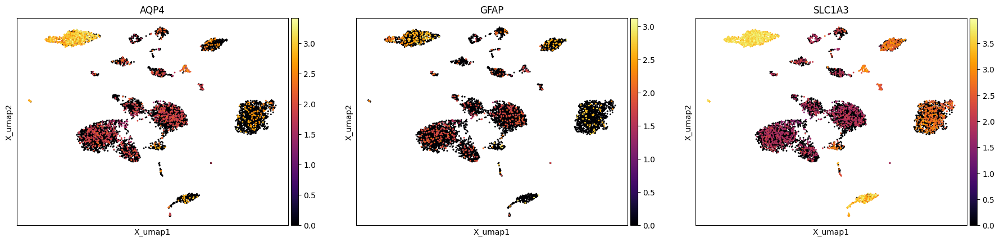

microglia


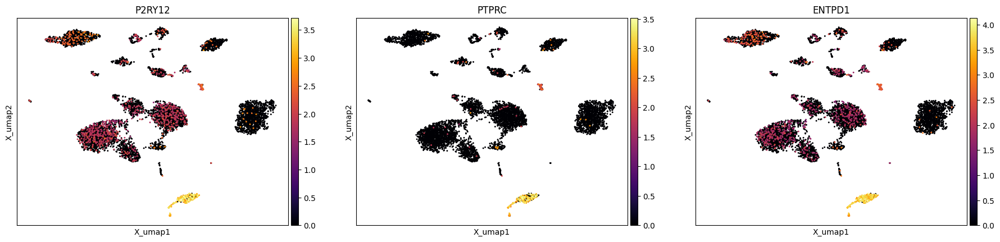

In [319]:
#PFC marker genes -> update these from papers
pfc_genes = {
    'spiny_projection_neuron': ['DRD2', 'DRD1', 'TAC1', 'GPR6', 'PENK'],
    'inhibitory_neuron': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
    'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
    'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
    'OPC': ['SOX10', 'OLIG2'],
    'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}

print('excitatory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['spiny_projection_neuron'], 
                use_raw = False, cmap = "inferno")
print('inhibitory')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['inhibitory_neuron'], 
                use_raw = False, cmap = "inferno")

print('opc')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['OPC'], 
                use_raw = False, cmap = "inferno")

print('oligodendrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['oligodendrocyte'], 
                use_raw = False, cmap = "inferno")

print('astrocyte')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['astrocyte'], 
                use_raw = False, cmap = "inferno")

print('microglia')
sc.pl.embedding(data, basis = 'X_umap', color = pfc_genes['microglia'], 
                use_raw = False, cmap = "inferno")

In [325]:
pfc_genes = {
    'spinyprojection_neuron': ['DRD2'],
    'inhibitory_neuron': ['GAD1'],
    'oligodendrocyte': ['MOG'],
    'astrocyte': ['AQP4'],
    'OPC': ['OLIG2'],
    'microglia': ['PTPRC']}

#allocate coarse labels based on mean expression
emp = np.full(data.obs.shape[0], 'undefined', dtype=object)
leid = np.asarray(data.obs['leiden'].values)

#neurons first
thresh = 0.5
for key in list(pfc_genes.keys())[:2]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]
            else:
                # If key not already in the label, append it
                if key not in current_label.split('_'):
                    emp[cluster_mask] = 'excitatory_inhibitory' #current_label + '_' + key[:4]

#glia
thresh = 0.5
for key in list(pfc_genes.keys())[2:]:
    gene = pfc_genes[key][0]
    gene_idx = data.var.index.get_loc(gene)
    for c in np.unique(leid):
        # Create a mask for the current cluster
        cluster_mask = data.obs['leiden'] == c
        # Calculate the mean expression for the current cluster
        mean_expression = np.mean(data.X[cluster_mask, gene_idx])
        if mean_expression > thresh:
            # Get the current label for the cluster
            current_label = np.unique(emp[cluster_mask])[0]
            
            # If 'None', assign the new key
            if current_label == 'undefined':
                emp[cluster_mask] = key.split('_')[0]

            elif pd.Series(current_label).str.contains('exci|inh')[0] == False:
                emp[cluster_mask] = 'mixed_glia' #current_label + '_' + key[:4]


# Assign coarse labels to the data object
data.obs['coarse_labels'] = emp

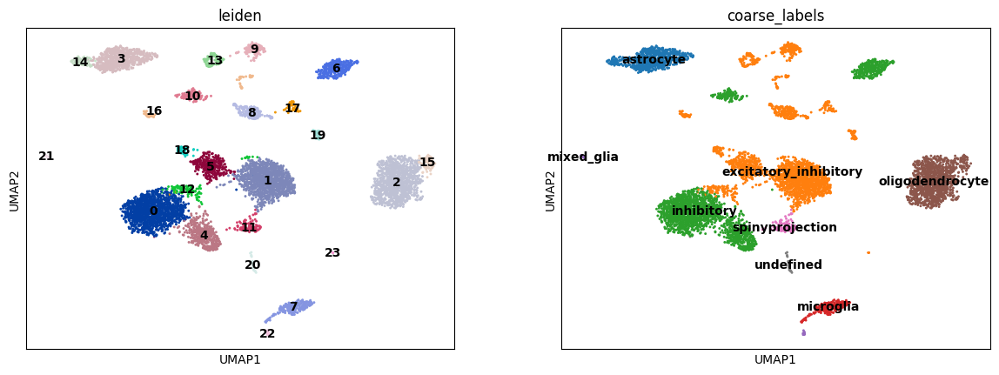

In [326]:
#UMAP labels
sc.pl.umap(data, color = ['leiden', 'coarse_labels'], legend_loc = 'on data')

/tmp/ipykernel_54735/2541556613.py:18: FutureWarning: The behavior of Series.argsort in the presence of NA values is deprecated. In a future version, NA values will be ordered last instead of set to -1.
  fdata = fdata[fdata.obs['coarse_labels'].argsort()]


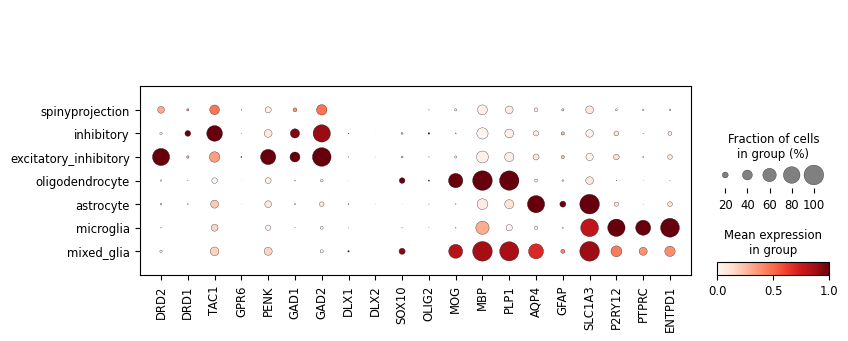

In [328]:
_genes = {
    'spinyprojection': ['DRD2', 'DRD1', 'TAC1', 'GPR6', 'PENK'],
    'inhibitory': ['GAD1', 'GAD2', 'DLX1', 'DLX2'],
    'oligodendrocyte': ['MOG', 'MBP', 'PLP1'],
    'astrocyte': ['AQP4', 'GFAP', 'SLC1A3'],
    'OPC': ['SOX10', 'OLIG2'],
    'microglia': ['P2RY12', 'PTPRC', 'ENTPD1']}


# Define the desired order for coarse_labels: neurons first, then glia
desired_order = ['spinyprojection', 'inhibitory', 'excitatory_inhibitory','OPC', 'oligodendrocyte', 'astrocyte', 'microglia', 'mixed_glia']

# Reorder `coarse_labels` in the dataset
fdata = data.copy()
fdata.obs['coarse_labels'] = pd.Categorical(fdata.obs['coarse_labels'], categories=desired_order, ordered=True)

# Sort the dataset by the new coarse_labels order
fdata = fdata[fdata.obs['coarse_labels'].argsort()]


# Flatten and reorder genes from pfc_genes based on `desired_order`
ordered_genes = []
for label in desired_order:
    if label in _genes:
        ordered_genes.extend(_genes[label])

# Plot the dot plot
sc.pl.dotplot(fdata, var_names=ordered_genes, groupby='coarse_labels', standard_scale='var')



/tmp/ipykernel_54735/1860171999.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


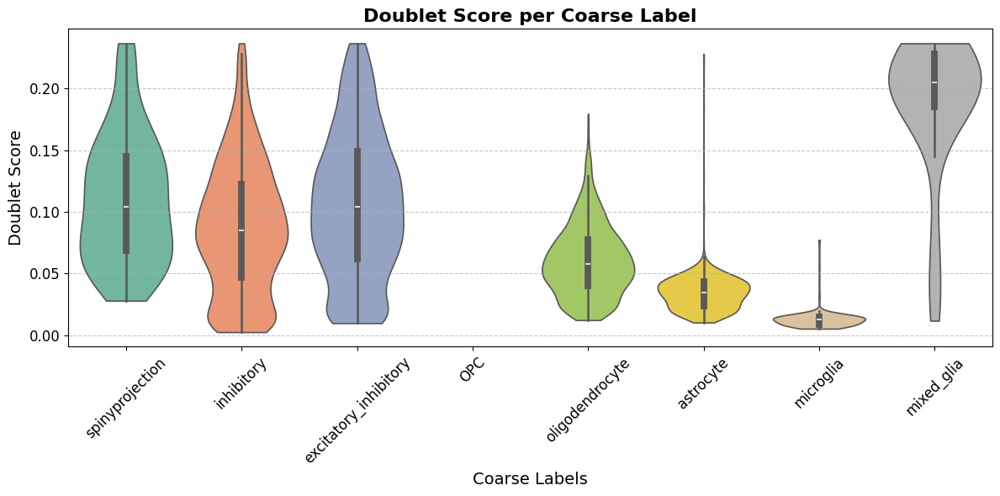

In [329]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd


# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for doublet scores with custom colors
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='Doublet Score',
    order=desired_order,  # Use the desired order
    palette=palette,  # Add colors
    cut=0  # Restrict violins to the range of the data
)

# Improve plot aesthetics
plt.title('Doublet Score per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Doublet Score', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/860890202.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()


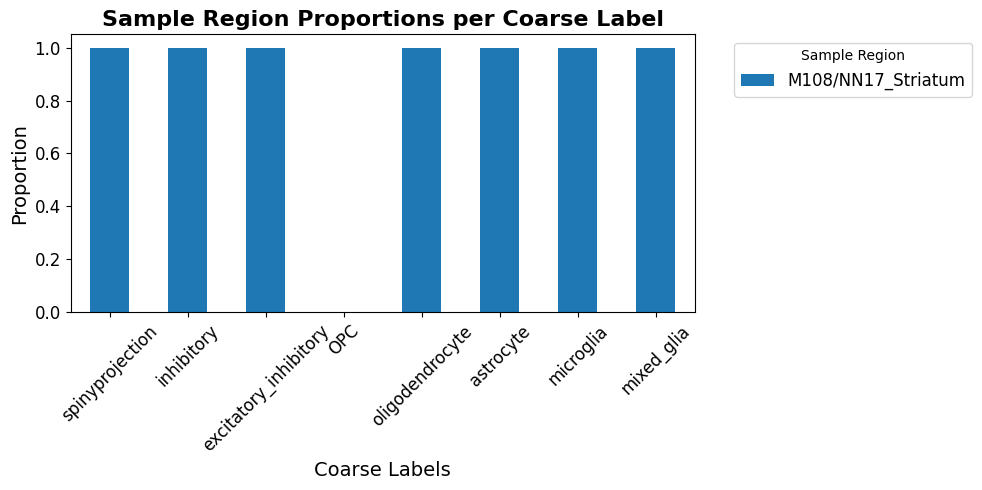

In [330]:

# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Calculate proportions and reorder rows based on `desired_order`
region_proportions = data.obs.groupby('coarse_labels')['Sample_region'].value_counts(normalize=True).unstack()
region_proportions = region_proportions.loc[desired_order]  # Reorder rows

# Stacked bar plot
region_proportions.plot(kind='bar', stacked=True, figsize=(10, 5), color=sns.color_palette("tab10"))
plt.title('Sample Region Proportions per Coarse Label', fontsize=16, weight='bold')
plt.ylabel('Proportion', fontsize=14)
plt.xlabel('Coarse Labels', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sample Region', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.tight_layout()
plt.show()


/tmp/ipykernel_54735/2651291409.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


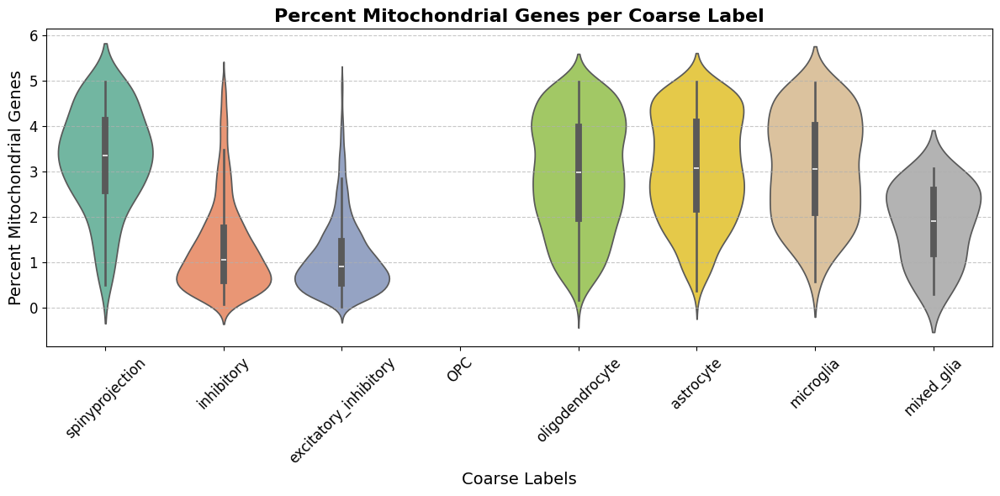

In [331]:
import seaborn as sns
import matplotlib.pyplot as plt


# Ensure 'coarse_labels' is a categorical column with the desired order
data.obs['coarse_labels'] = pd.Categorical(data.obs['coarse_labels'], 
                                           categories=desired_order, 
                                           ordered=True)

# Define a custom color palette for the violin plot
palette = sns.color_palette("Set2", len(desired_order))

# Violin plot for percent mitochondrial genes
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=data.obs,
    x='coarse_labels',
    y='percent_mito',
    order=desired_order,  # Use desired order
    palette=palette  # Add colors
)

# Improve plot aesthetics
plt.title('Percent Mitochondrial Genes per Coarse Label', fontsize=16, weight='bold')
plt.xlabel('Coarse Labels', fontsize=14)
plt.ylabel('Percent Mitochondrial Genes', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


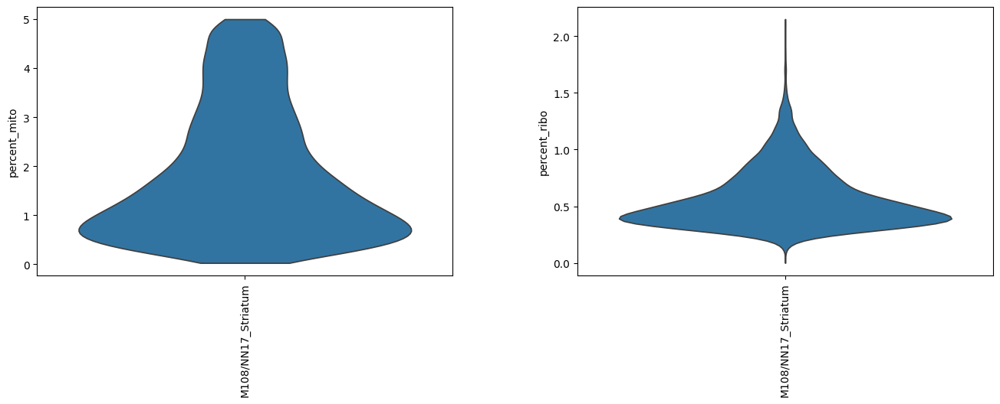

In [58]:
sc.pl.violin(data, ['percent_mito','percent_ribo'], stripplot = False,
             jitter=0.4, groupby = "Sample_region", rotation=90)
plt.show()

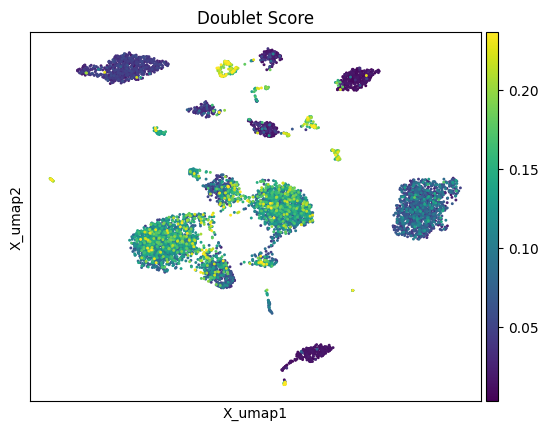

In [59]:
sc.pl.embedding(data, basis = 'X_umap', color = 'Doublet Score')
plt.show()

In [60]:
sc.tl.rank_genes_groups(
    data, groupby="leiden", method="wilcoxon", key_added="dea_leiden"
)

/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/AD/xic007/miniforge3/envs/scorch/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:

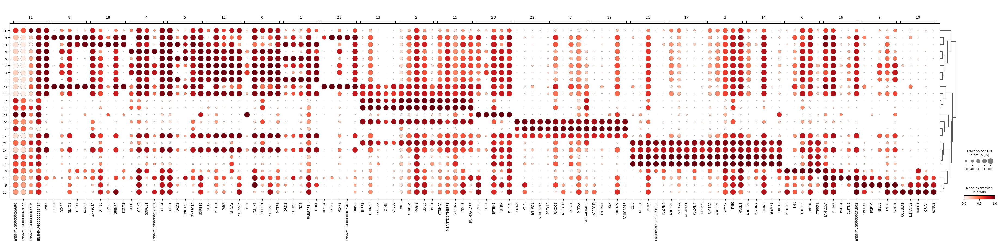

In [61]:
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden", standard_scale="var", n_genes=5, key="dea_leiden"
)

In [62]:
sc.tl.filter_rank_genes_groups(
    data,
    min_in_group_fraction=0.2,
    max_out_group_fraction=0.2,
    key="dea_leiden",
    key_added="dea_leiden_filtered",
)

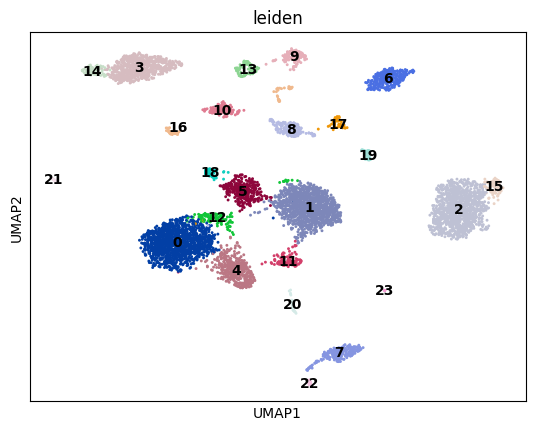

In [63]:
sc.pl.umap(data, color = 'leiden', legend_loc = 'on data')

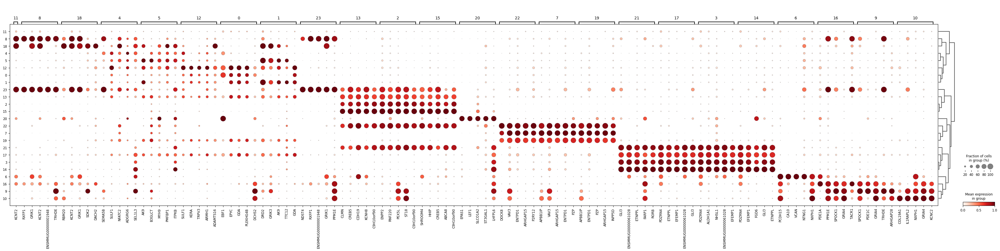

In [64]:
sc.pl.rank_genes_groups_dotplot(
    data,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_filtered",
)

In [78]:
marker_genes = [
    # 'DOCK8', 'MOBP', 'GFAP', 'RBFOX3', 'SLC17A6', 'GAD1', 'LHFPL3', 'COBLL1', 
                'DRD1', 'DRD2','CHAT','PVALB','VIP',
'GAD1','GAD2','SLC32A1',
'SLC17A8']

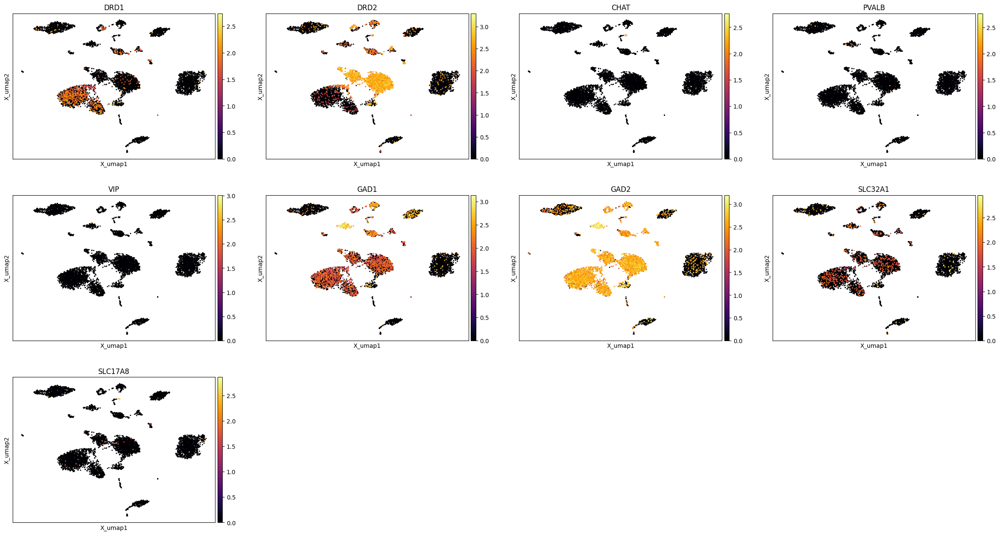

In [79]:
sc.pl.embedding(data, basis = 'X_umap', color = marker_genes, 
                use_raw = False, cmap = "inferno")

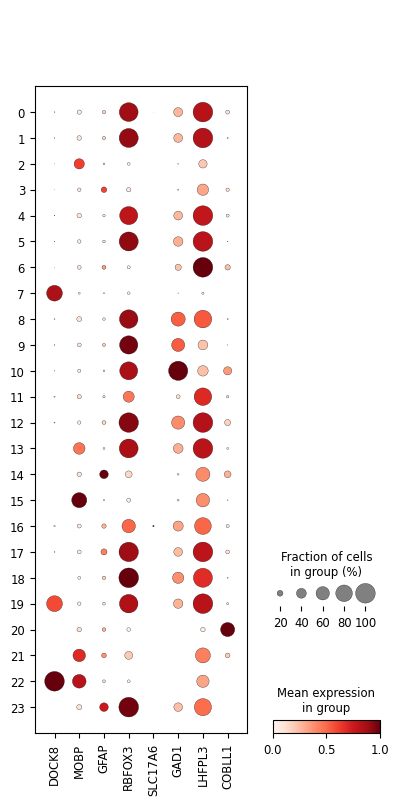

In [51]:
sc.pl.dotplot(data, var_names = marker_genes, groupby = 'leiden', standard_scale = 'var')